# What I Learned From Analyzing 30,000+ Video Game Ratings
<img src='https://pixabay.com/get/gbe189f56779ab10240126176a18155db13f5f4210b2fa46c2b89f078c136c0a03188ebf03bacfa53e9e8f1653e2cf4c7.jpg'></img>
<figcaption style="text-align: center;">
    <strong>
        Image by <a href="https://pixabay.com/users/alexas_fotos-686414/?utm_source=link-attribution&amp;utm_medium=referral&amp;utm_campaign=image&amp;utm_content=1557240">Alexa</a> from <a href="https://pixabay.com//?utm_source=link-attribution&amp;utm_medium=referral&amp;utm_campaign=image&amp;utm_content=1557240">Pixabay</a>
    </strong>
</figcaption>

# 1. Introduction to the Dataset And The Aim of the EDA

IGDB.com is a video game database (acquired by Amazon-owned Twitch), intended for both game consumers and video game professionals alike. IGDB stands for Internet Game Database and consists of 2 primary parts, an online website consisting of a website and 3 mobile apps that provide game consumers with structured and up to date information about games and the gaming world.

This dataset of more than 200K games is collected from [IGDB API](https://api-docs.igdb.com/#about) using [igdb-api-v4 for python](https://github.com/twitchtv/igdb-api-python) but only about 30K+ games have ratings.
This notebook explores any common trends for games that have ratings from igdb and external critics.

Most importantly, we will try to answer these questions:
1) What's the proportion of games in each gaming platform?
2) How do game ratings look for different platforms, genres, themes, age ratings and player perspectives and discuss the reasons.
3) Do Multi player games get higher rating than single player games regardless of platforms, genres, themes, age ratings and player perspectives?
4) Which gaming platform sees more rating success for each genre?
5) Which groups contribute most to great games (games that have a rating of higher than 75)


In [1]:
# Base libraries
import time
import datetime
import os

# Scientific libraries
import numpy as np
import pandas as pd
from empiricaldist import Cdf, Pmf

# Visual libraries
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib.cm import get_cmap
import seaborn as sns
import missingno as msno  # Visualize missing values

import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
# This ensures Plotly output works in multiple places:
# plotly_mimetype: VS Code notebook UI
# notebook: "Jupyter: Export to HTML" command in VS Code
# See https://plotly.com/python/renderers/#multiple-renderers
pio.renderers.default = "plotly_mimetype+notebook"


# Helper libraries
from tqdm.notebook import tqdm, trange
from colorama import Fore, Back, Style
import warnings
warnings.filterwarnings('ignore')

# Visual setup
import matplotlib.ticker as ticker
plt.style.use('ggplot')
rcParams['axes.spines.right'] = False
rcParams['axes.spines.top'] = False
rcParams['figure.figsize'] = [12, 9]
rcParams['font.size'] = 16
plt.rc('xtick', labelsize=12)
plt.rc('ytick', labelsize=12)
custom_colors = ['#74a09e','#86c1b2','#98e2c6','#f3c969','#f2a553', '#d96548', '#c14953']
sns.set_palette(custom_colors)
%config InlineBackend.figure_format = 'retina'
%config Completer.use_jedi = False

# Pandas options
pd.set_option('max_colwidth', 40)
pd.options.display.max_columns = None  # Possible to limit
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

# Seed value for numpy.random
np.random.seed(42)

Load in the data:

In [2]:
#read data ignoring the index and id columns
df = pd.read_csv("data_200K.csv", usecols=lambda x: x not in ['Unnamed: 0', 'id'])
df.head()

,category,created_at,external_games,first_release_date,game_modes,genres,name,platforms,release_dates,screenshots,similar_games,slug,status,summary,tags,themes,updated_at,url,websites,age_ratings,involved_companies,parent_game,game_engines,player_perspectives,videos,rating,rating_count,storyline,total_rating,total_rating_count,version_parent,version_title,hypes,franchises,follows,franchise,aggregated_rating,aggregated_rating_count,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks
0,0,1495739021,"[5526, 107828, 1927694]",1.459987e+09,[1],"[15, 32]",The Fifth Expedition,"[3, 6]","[77732, 77733]","[58357, 58358, 58359, 58360, 58361]","[25311, 25640, 34024, 36553, 37419, ...",the-fifth-expedition,4.0,Guide your team of explorers into th...,"[1, 268435471, 268435488]",[1],1643442946,https://www.igdb.com/games/the-fifth...,"[33480, 33481]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0,1498435200,"[20127, 1988884]",5.364576e+08,NaN,[5],Dogou Souken,[52],[91007],NaN,"[12364, 27270, 43367, 103281, 103292...",dogou-souken,NaN,An overhead-view shoot'em up game.,[268435461],NaN,1604620800,https://www.igdb.com/games/dogou-souken,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,1517392813,"[216805, 1969751, 2005770]",1.404346e+09,NaN,[9],City Mysteries,[37],[138333],"[155025, 155026, 155027]","[10603, 19222, 25905, 41349, 86974, ...",city-mysteries,NaN,"Search buildings, streets, landmarks...",[268435465],NaN,1641425677,https://www.igdb.com/games/city-myst...,NaN,[37944],"[130531, 130532]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,1628007985,[2028338],NaN,NaN,NaN,Earth Defense Force: World Brothers ...,NaN,NaN,"[567675, 567676, 567677, 567678, 567...","[25636, 100800, 103298, 103301, 1033...",earth-defense-force-world-brothers-r...,NaN,"Riho Futaba (voiced by Yuko Goto), a...",[1],[1],1643475000,https://www.igdb.com/games/earth-def...,[208872],NaN,NaN,139067.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,1602368467,[1966278],1.525910e+09,[1],[32],sun machine,[82],[213594],"[403247, 403248]","[11666, 13200, 13660, 17130, 25311, ...",sun-machine,NaN,"a story of dark days, chronic fatigu...","[18, 268435488, 536896982]",[18],1639609570,https://www.igdb.com/games/sun-machine,[156114],NaN,[117090],NaN,[837],[3],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##### Data Dictionary

- category - has codes to indicate if a game is a main game, dlc, expansion, bundle etc.
- created_at - Date this was initially added to the IGDB database
- external_games - External IDs this game has on other services
- first_release_date - The first release date for this game
- game_modes - Single player, Multiplayer etc
- genres - Genres of the game
- name - name of the game
- platforms - Platforms this game was released on
- release_dates - Release dates of this game (includes any re-releases)
- screenshots - Screenshots of this game
- similar games - Similar games
- slug - A url-safe, unique, lower-case version of the name
- status - status of the game whether it is released, cancelled, early access etc
- summary - A description of the game
- tags - Related entities in the IGDB API
- themes - Themes of the game
- updated_at - The last date this entry was updated in the IGDB database
- url - 	The website address (URL) of the item
- websites - Websites associated with this game
- age_ratings - Age Rating according to various rating organisations
- involved_companies - Companies who developed this game
- parent_game - If a DLC, expansion or part of a bundle, this is the main game or bundle
- game_engines - The game engine used in this game
- player_perspectives - The main perspective of the player
- videos - Videos of this game
- rating - Average IGDB user rating
- rating_count - Total number of IGDB user ratings
- stroyline - A short description of a games story
- total_rating - Average rating based on both IGDB user and external critic scores
- total_rating_count - Total number of user and external critic scores
- version_parent - If a version, this is the main game
- version_title - Title of this version (i.e Gold edition)
- hypes - Number of follows a game gets before release
- franchies - Other franchises the game belongs to
- follows - Number of follows a game gets after release
- franchise - The main franchise
- aggregated_rating - Rating based on external critic scores
- aggregated_rating_count - Number of external critic scores
- multiplayer_modes - Multiplayer modes for this game
- dlcs - DLCs for this game
- ports - 	Ports of this game
- expansions - Expansions games of this game
- remakes - Remakes of this game
- expanded_games - Expanded games of this game
- remasters - Remasters of this game
- standalone_expansions - Standalone expansions of this game
- forks - Forks of this game

# 2. Basic Exploration and Data Cleaning

## 2.1 Basic Exploration

We will start with basic exploration of the dataset and see no. of non-null values and data types.

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 201812 entries, 0 to 201811
Data columns (total 47 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   category                 201812 non-null  int64  
 1   created_at               201812 non-null  int64  
 2   external_games           192157 non-null  object 
 3   first_release_date       115916 non-null  float64
 4   game_modes               96545 non-null   object 
 5   genres                   156697 non-null  object 
 6   name                     201812 non-null  object 
 7   platforms                120738 non-null  object 
 8   release_dates            120466 non-null  object 
 9   screenshots              135835 non-null  object 
 10  similar_games            163187 non-null  object 
 11  slug                     201812 non-null  object 
 12  status                   12288 non-null   float64
 13  summary                  167394 non-null  object 
 14  tags

There are 47 columns, 201812 rows and several of them have a lot of missing values.

In [17]:
# Count how many times each data type is present in the dataset
pd.value_counts(df.dtypes)

object     31
float64    13
int64       3
dtype: int64

We have 31 object type column and 16 numeric columns.

Let's see non-numerical features.

In [18]:
# Display non-numerical features
df.select_dtypes(exclude="number").head()

,external_games,game_modes,genres,name,platforms,release_dates,screenshots,similar_games,slug,summary,tags,themes,url,websites,age_ratings,involved_companies,game_engines,player_perspectives,videos,storyline,version_title,franchises,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks
0,"[5526, 107828, 1927694]",[1],"[15, 32]",The Fifth Expedition,"[3, 6]","[77732, 77733]","[58357, 58358, 58359, 58360, 58361]","[25311, 25640, 34024, 36553, 37419, ...",the-fifth-expedition,Guide your team of explorers into th...,"[1, 268435471, 268435488]",[1],https://www.igdb.com/games/the-fifth...,"[33480, 33481]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,"[20127, 1988884]",NaN,[5],Dogou Souken,[52],[91007],NaN,"[12364, 27270, 43367, 103281, 103292...",dogou-souken,An overhead-view shoot'em up game.,[268435461],NaN,https://www.igdb.com/games/dogou-souken,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"[216805, 1969751, 2005770]",NaN,[9],City Mysteries,[37],[138333],"[155025, 155026, 155027]","[10603, 19222, 25905, 41349, 86974, ...",city-mysteries,"Search buildings, streets, landmarks...",[268435465],NaN,https://www.igdb.com/games/city-myst...,NaN,[37944],"[130531, 130532]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,[2028338],NaN,NaN,Earth Defense Force: World Brothers ...,NaN,NaN,"[567675, 567676, 567677, 567678, 567...","[25636, 100800, 103298, 103301, 1033...",earth-defense-force-world-brothers-r...,"Riho Futaba (voiced by Yuko Goto), a...",[1],[1],https://www.igdb.com/games/earth-def...,[208872],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,[1966278],[1],[32],sun machine,[82],[213594],"[403247, 403248]","[11666, 13200, 13660, 17130, 25311, ...",sun-machine,"a story of dark days, chronic fatigu...","[18, 268435488, 536896982]",[18],https://www.igdb.com/games/sun-machine,[156114],NaN,[117090],[837],[3],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


We are interested in genres, platforms, themes, age_ratings, player_perspectives. But these columns have a list of codes and we need to get the description for these codes later to get any meaningful insight.

Let's see numerical features.

In [19]:
# Display numerical features
df.select_dtypes(include="number").head()

,category,created_at,first_release_date,status,updated_at,parent_game,rating,rating_count,total_rating,total_rating_count,version_parent,hypes,follows,franchise,aggregated_rating,aggregated_rating_count
0,0,1495739021,1.459987e+09,4.0,1643442946,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0,1498435200,5.364576e+08,NaN,1604620800,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,1517392813,1.404346e+09,NaN,1641425677,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,1628007985,NaN,NaN,1643475000,139067.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,1602368467,1.525910e+09,NaN,1639609570,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


first_release_date, all rating related columns, hypes, and follows. Hypes = no. of follows before a game release. Follows = no. of follows after a game release.

Let's explore the missing values now.

In [20]:
df.isnull().sum()

category                        0
created_at                      0
external_games               9655
first_release_date          85896
game_modes                 105267
genres                      45115
name                            0
platforms                   81074
release_dates               81346
screenshots                 65977
similar_games               38625
slug                            0
status                     189524
summary                     34418
tags                        38598
themes                      98690
updated_at                      0
url                             0
websites                    73589
age_ratings                158039
involved_companies         118302
parent_game                182153
game_engines               185789
player_perspectives        141230
videos                     159580
rating                     173405
rating_count               173405
storyline                  185530
total_rating               168538
total_rating_c

Many columns have large portion of missing values. 
Not all these columns will be useful for us as the dataset appears to be sparse. Let's exclude unnecessary columns later.

Next, looking at the dataset info again:

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 201812 entries, 0 to 201811
Data columns (total 47 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   category                 201812 non-null  int64  
 1   created_at               201812 non-null  int64  
 2   external_games           192157 non-null  object 
 3   first_release_date       115916 non-null  float64
 4   game_modes               96545 non-null   object 
 5   genres                   156697 non-null  object 
 6   name                     201812 non-null  object 
 7   platforms                120738 non-null  object 
 8   release_dates            120466 non-null  object 
 9   screenshots              135835 non-null  object 
 10  similar_games            163187 non-null  object 
 11  slug                     201812 non-null  object 
 12  status                   12288 non-null   float64
 13  summary                  167394 non-null  object 
 14  tags

Some columns have incorrect data types. created_at and first_release_date are in unix timestamp and need to be converted to datetime format.

Now, let's explore the numerical features of the dataset and see if they contain any issues:

In [22]:
# Display in normal notation instead of scientific
with pd.option_context('float_format', '{:f}'.format):
    df.describe()

,category,created_at,first_release_date,status,updated_at,parent_game,rating,rating_count,total_rating,total_rating_count,version_parent,hypes,follows,franchise,aggregated_rating,aggregated_rating_count
count,201812.000000,201812.000000,115916.000000,12288.000000,201812.000000,19659.000000,28407.000000,28407.000000,33274.000000,33274.000000,5057.000000,8520.000000,21268.000000,1522.000000,14197.000000,14197.000000
mean,0.415198,1552772717.998132,1310630812.436592,3.951497,1633893407.702570,60131.704410,66.549716,20.232020,66.354925,18.844714,62754.630809,3.893545,11.354711,132.422470,68.875231,3.684440
std,1.704122,73971292.947405,339450765.067517,1.116590,25232072.207712,61167.169800,14.426715,99.293201,14.726604,93.382958,59818.832293,18.574610,47.328321,122.131167,16.147509,4.124116
min,0.000000,1297556438.000000,-694396800.000000,0.000000,1432684800.000000,1.000000,10.001966,0.000000,0.000000,0.000000,4.000000,1.000000,1.000000,1.000000,0.000000,0.000000
25%,0.000000,1501632000.000000,1130976000.000000,4.000000,1616353472.000000,6494.000000,59.376556,0.000000,58.751052,0.000000,9191.000000,1.000000,1.000000,26.000000,60.000000,1.000000
50%,0.000000,1535932800.000000,1456704000.000000,4.000000,1643460369.500000,33463.000000,70.000000,1.000000,70.000000,1.000000,33740.000000,1.000000,2.000000,93.500000,71.000000,2.000000
75%,0.000000,1627934612.500000,1560470400.000000,4.000000,1651746074.500000,116330.000000,78.122080,8.000000,77.500000,8.000000,119304.000000,2.000000,5.000000,222.000000,80.000000,4.000000
max,12.000000,1661597514.000000,1923955200.000000,8.000000,1661619245.000000,214619.000000,100.000000,3541.000000,100.000000,3578.000000,214675.000000,1038.000000,1779.000000,444.000000,100.000000,59.000000


Rating related columns seem to have values ranging from 0 to 100 as expected and do not have any outliers. total_rating seems to be the most populated one compared to rating and aggregated_rating but it is still missing for many games.

Average total_rating is 66 for all games but median is 70.

When the median is larger than the mean, it means that most of the weighted data is bunched up toward the right (higher frequency of larger numbers) with a “tail” stretching towards the left.

We will explore a bit more and decide if we should focus on total_rating for our analysis.

Let's see no. of unique values in each of the non-numerical features.

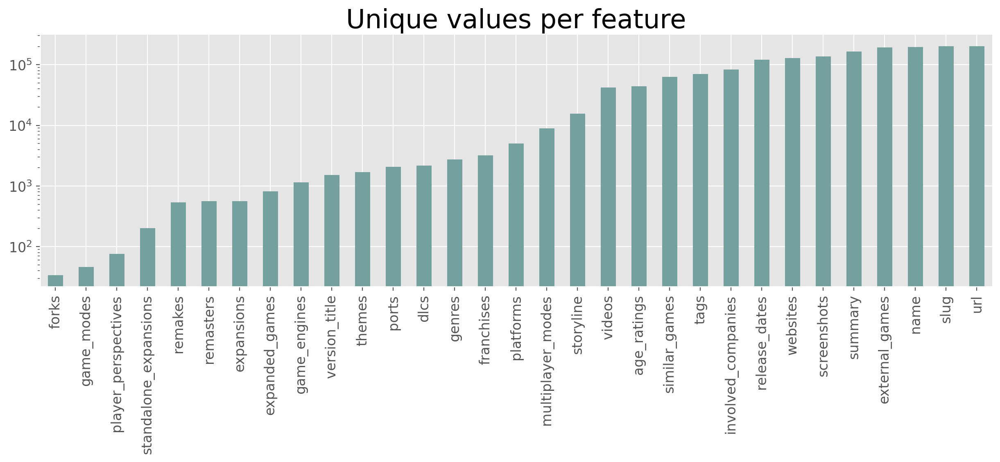

In [23]:
# For each numerical feature compute number of unique entries
unique_values = df.select_dtypes(exclude="number").nunique().sort_values()

# Plot information with y-axis in log-scale
unique_values.plot.bar(logy=True, figsize=(15, 4), title="Unique values per feature");

We can see there's too many unique values in the columns we are interested in and they are of no use if we do not unpack those values or simplify the data. We atleast have to go with the most frequently occuring values in features.

Before we further explore, let's deal with the issues we highlighted. Here is the final list:

### Issues List For the Dataset
- Drop unnecessary columns or columns that do not provide useful information to answer our questions.
- Incorrect data types for some columns.
- Missing values in several columns. Some columns may not even be useful as they are sparsely populated.
- Many columns have ids in a list that need their descriptions to be mapped from other datasets.
- Drop unnecessary categories or unpack values in columns as most of them seem to have 1000s of category combinations. For example, platform column has ['action', 'adventure', 'shooting'] for each game. This would not be useful if we want to analyze how each variable/group is related to total_rating unless we unpack or simplify each observation.

## 2.2 Data Cleaning

We can drop external_games (external ids that a game has on other platform_descriptions/services), parent_game (if the game is a parent or a spin off), screenshots, tags and urls.
game_modes has information on whether a game is a single player, multi player etc but it has a lot of missing data. More over, we can get this single player vs multi player flags from other column which comes later in the notebook. So, it can be excluded here.


### Drop unnecessary columns

In [4]:
# Specify the cols to drop
to_drop = [
    'external_games',
    'parent_game', 'screenshots', 'tags', 'url', 'game_modes'
]

# Drop them
df.drop(to_drop, axis='columns', inplace=True)


### Convert to Correct Data Types

In [5]:
df['first_release_date'] = pd.to_datetime(df['first_release_date'],unit='s')
df['created_at'] = pd.to_datetime(df['created_at'],unit='s')
df['updated_at'] = pd.to_datetime(df['updated_at'],unit='s')
df.tail()


,category,created_at,first_release_date,genres,name,platforms,release_dates,similar_games,slug,status,summary,themes,updated_at,websites,age_ratings,involved_companies,game_engines,player_perspectives,videos,rating,rating_count,storyline,total_rating,total_rating_count,version_parent,version_title,hypes,franchises,follows,franchise,aggregated_rating,aggregated_rating_count,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks
201807,0,2015-04-27 21:21:50,2015-12-07,"[10, 13, 14]",DiRT Rally,"[3, 6, 14, 48, 49]","[41565, 41566, 43439, 68522, 68524, ...","[3772, 7350, 9278, 11646, 19082, 267...",dirt-rally,NaN,DiRT Rally is a racing video game fo...,[32],2022-08-23 23:30:48,"[5399, 21637, 21638, 21639, 21640, 2...","[12256, 12257]","[46179, 97171]",[99],"[1, 2, 7]","[5156, 6405, 6406, 6414, 7774]",82.757992,95.0,NaN,83.763612,110.0,NaN,NaN,4.0,NaN,47.0,NaN,84.769231,15.0,[8048],NaN,[136176],NaN,NaN,NaN,NaN,NaN,NaN
201808,0,2022-08-24 18:40:32,2022-08-22,"[31, 32]",Umami Island,[6],[383050],"[28070, 28277, 94772, 96217, 106987,...",umami-island,NaN,Umami Island is an adventure game wh...,[17],2022-08-24 19:41:11,"[306053, 306054, 306055, 306056]",NaN,NaN,[1251],[1],[73739],NaN,NaN,This is a short Adventure Farming ga...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
201809,0,2017-06-22 09:38:27,1996-03-21,"[9, 33]",Magical Drop II,"[5, 32, 52, 58, 80, 136]","[126696, 140909, 140910, 140911, 311...","[24426, 25905, 28010, 28070, 55984, ...",magical-drop-ii,NaN,Magical Drop is played in a style an...,[17],2022-08-24 19:41:18,"[225709, 225710]","[46067, 46068]","[149167, 149168, 149169, 149170]",[1222],[4],"[23854, 54804]",78.219344,6.0,NaN,78.219344,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[9134],NaN,"[99509, 171096]",NaN,NaN,NaN,NaN,NaN,NaN
201810,5,2022-08-24 17:29:21,2020-01-23,"[12, 15, 24]",Fire Emblem: The Four Kings,[24],[383026],NaN,fire-emblem-the-four-kings,NaN,The story centers on three brothers:...,NaN,2022-08-24 19:40:04,[306049],NaN,NaN,NaN,[3],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
201811,5,2022-08-24 17:32:54,2021-05-28,"[12, 15, 24]",Fire Emblem: Four Kings: Deposition,[24],[383027],NaN,fire-emblem-four-kings-deposition,NaN,"This is Four Kings: Deposition, a sh...",NaN,2022-08-24 19:39:57,[306051],NaN,NaN,NaN,[3],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Deal With Missing Values

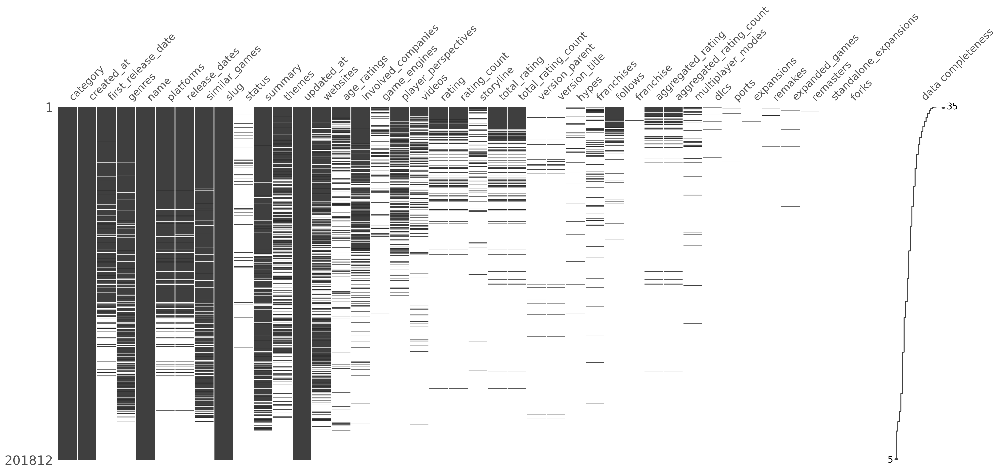

In [27]:
msno.matrix(df, labels=True, sort="descending");

This dataset seems to become increasingly sparse as we go from top left to bottom right! Much of the data is missing.

This is one of the challenges with the data collection. We do not know how complete the data is until we have finished collecting all the data through api. In this case, the api had a limit of 500 rows per request and so I had to do multiple requests in a loop. It's turning out to be an underwhelming dataset!

let's now look at the number of missing values per feature

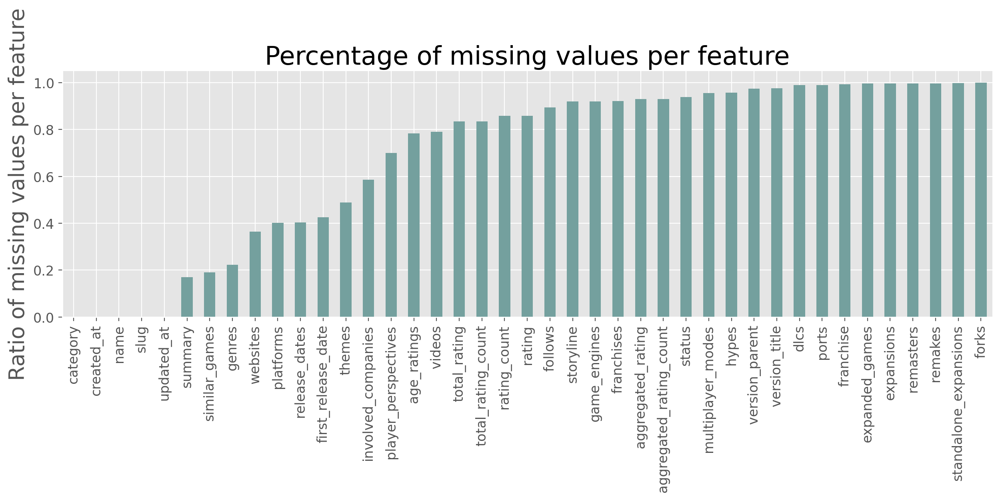

In [28]:
df.isna().mean().sort_values().plot(
    kind="bar", figsize=(15, 4),
    title="Percentage of missing values per feature",
    ylabel="Ratio of missing values per feature");

Most of the features in the dataset have more than 50% of missing values which is underwhelming. Many of these would have to be dropped depending the goals if we want to build models. For example, if we want to drop any feature that has more than 20% of missingness, we can use df.dropna(thresh=df.shape[0] * 0.85, axis=1).

But for now, let's just focus on the exploratory data analysis.
Out of all rating related columns, although they all have more than 80% of missingness, total_rating seems to have least missing values.

Let's plot the missingness correlation:

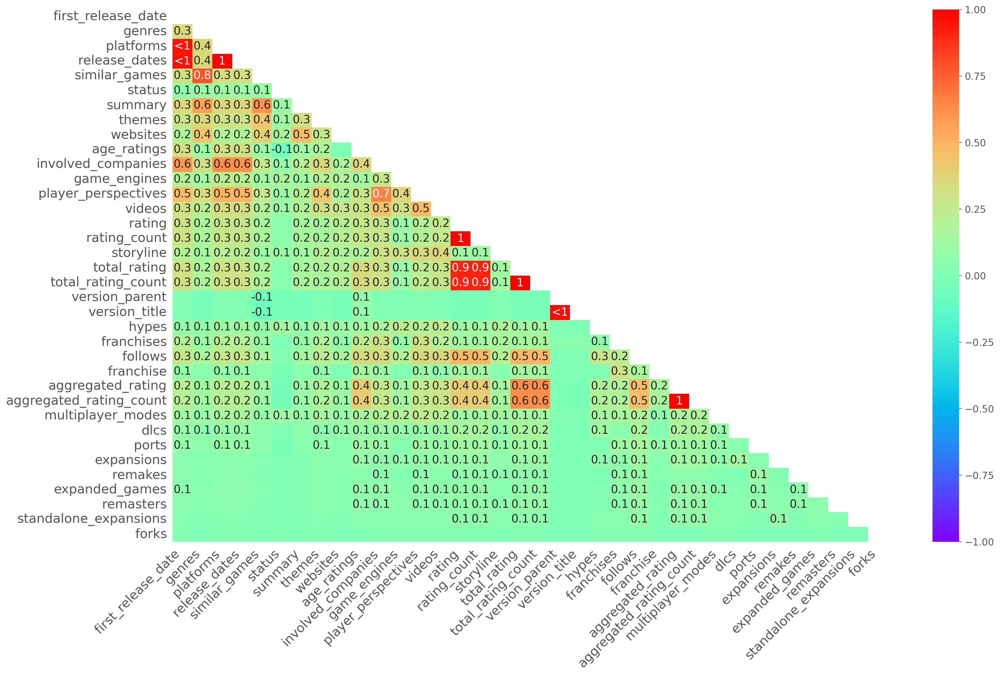

In [29]:
msno.heatmap(df, cmap='rainbow');

The correlation matrix of missingness shows that:

- release_dates and first_release_date are populated (or missing) whenever platform_descriptions is populated (or missing)
- all rating_count and rating related columns are highly correlated for missingness as expected
- similar_games is populated if genre is populated in most cases
- player_perspectives is populated when involved_companies is populated in most cases


We are most interested in total_rating as we are assuming this indicates the success of a game. It has less missingness compared to other rating features and it is also the average rating based on both IGDB user and external critic scores. It's missingness seems to be random and does not depend on any particular variable other than total_rating_count, rating and rating_count which is expected.

Let us drop all rows that have a missing total_rating as these are not useful for our analysis.

In [6]:
df_ratings = df.dropna(subset = ['total_rating'], axis = 0)
df_ratings.shape
df_ratings.head()

(33274, 41)

,category,created_at,first_release_date,genres,name,platforms,release_dates,similar_games,slug,status,summary,themes,updated_at,websites,age_ratings,involved_companies,game_engines,player_perspectives,videos,rating,rating_count,storyline,total_rating,total_rating_count,version_parent,version_title,hypes,franchises,follows,franchise,aggregated_rating,aggregated_rating_count,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks
15,0,2016-03-08 17:38:57,2010-04-20,[7],Beat City,[20],"[47952, 47953]","[11711, 18981, 54774, 63933, 67774, ...",beat-city,NaN,A rhythm-based mini-game collection ...,[1],2022-05-11 20:44:24,NaN,"[8122, 8123]","[164713, 164714]",NaN,[4],NaN,60.00000,0.0,"Can you feel the beat? Life, color, ...",60.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23,0,2018-05-07 00:00:00,NaT,"[14, 33]",Flying Arrow!.,NaN,NaN,"[14733, 87053, 90965, 109606, 116349...",flying-arrow--1,NaN,Flying Arrow is a game control throw...,NaN,2020-11-06 00:00:00,[78501],[21881],NaN,NaN,NaN,NaN,34.16185,0.0,NaN,34.16185,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
46,9,2018-02-23 10:46:00,2013-05-15,"[8, 33]",Sonic the Hedgehog Classic,"[34, 39]","[189309, 193673, 193674]","[25901, 28070, 43367, 51485, 55042, ...",sonic-the-hedgehog-classic,NaN,A remastered port of Sonic the Hedge...,[1],2022-06-09 16:44:32,"[76549, 139109, 139110, 275708]",NaN,"[171549, 171550]",[881],[4],NaN,80.00000,1.0,NaN,80.00000,1.0,NaN,NaN,NaN,[457],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
55,0,2019-03-17 15:12:50,2020-02-20,[32],Monster Jaunt,"[6, 14]","[187859, 189529]","[65827, 75948, 94741, 106992, 111043...",monster-jaunt,NaN,A throwback minigame party that won'...,NaN,2021-10-18 19:42:58,"[103282, 103283, 235726, 235728, 235...",NaN,[92093],NaN,NaN,[33557],70.00000,0.0,NaN,70.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
57,0,2016-09-22 18:55:27,NaT,NaN,Memorick: The Apprentice Knight,NaN,NaN,NaN,memorick-the-apprentice-knight,NaN,NaN,NaN,2022-04-14 20:16:08,NaN,[65727],NaN,NaN,NaN,NaN,NaN,NaN,NaN,69.00000,1.0,NaN,NaN,NaN,NaN,NaN,NaN,69.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


A little disappointing that the size of our dataset drastically reduced (from 201812 rows to 33274 rows) after dropping rows with missing total_rating.

Let's get a global view of our data and see if we can get any ideas for cleaning or analysis.

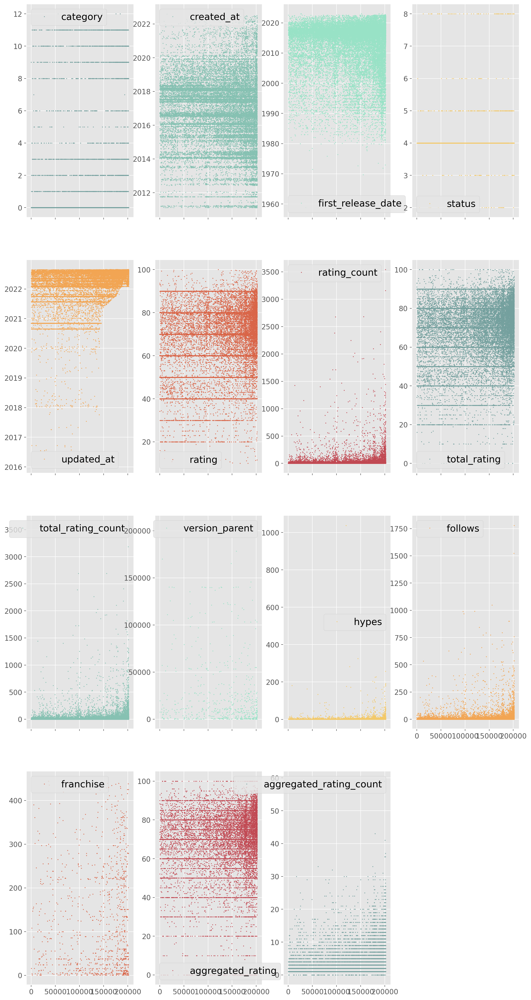

In [7]:
df_ratings.plot(lw=0, marker=".", subplots=True, layout=(-1, 4),
          figsize=(15, 30), markersize=1);

The y-axis shows the feature value, while the x-axis is the sample index (row) from our dataset.

Category seems to be mostly 0 which indicates that a vast majority of the games belong to 'main game' category. For documentation, please visit https://api-docs.igdb.com/#game

Most frequently occuring value in status is 4 which is a code for early_access. I expected this to be 1 (code for games released). As it stands, this feature is not so clear on how to interpret it.

Hypes, follows and rating_count seem to exhibit very similar patterns and its either there's more followers or more emphasis on data collection (may be they made it more accessible to follow a game?) for these in the last few years.

More data has been populated around 2018. First release date and updated at columns have more density in the last 5 years indicating that this dataset might have more features populated for 'new' games.

Rating features have clear dense points at 50, 60, 70... confirming that people usually rate in tens units which is common in these kinds of datasets.

# 3. Univariate Exploration

We will look at the distribution of the numerical features of the dataset. 

Let's start with rating:

In [31]:
fig = px.histogram(df_ratings, x="total_rating", nbins = 55, title = "A Histogram of Game Ratings")
fig.show()

Histogram shows that majority of the games are rated between 50 and 80 with peak at 70.

Let's plot a histogram for all numerical features.

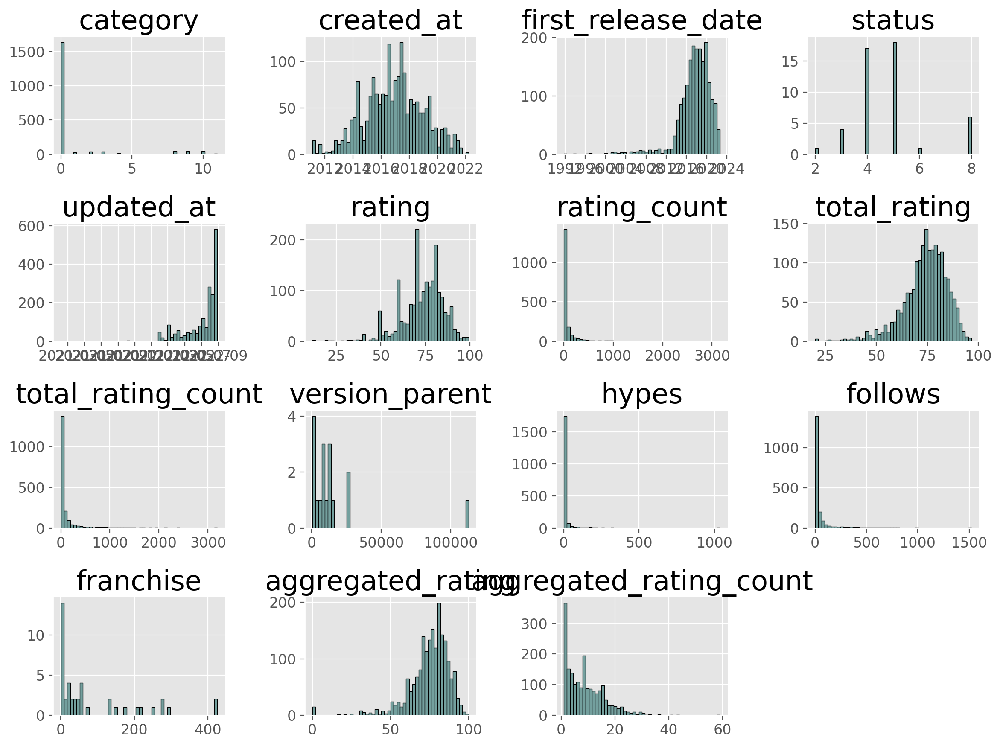

In [32]:
# Get rid off zeroes as they overshadow other values
df_ratings_for_hist = df_ratings.query('rating_count > 0 & total_rating_count > 0 & hypes > 0 & follows > 0 & aggregated_rating_count > 0')
#df_ratings_for_hist.describe()
# Plots the histogram for each numerical feature in a separate subplot
df_ratings_for_hist.hist(bins=50, edgecolor="black") #figsize=(15, 25), layout=(-1, 5)
plt.tight_layout();

Getting rid off zeroes in total_rating_count and other rating count columns eliminates the spikes we see at 50, 60, 70 and 80 ratings which means that for most of the games, even though their total_rating_count/rating_count/aggregated_rating_count is zero, the rating column was filled with scores in tens units (50, 60, 70,...).
Most of the ratings seem to have come from just one source based on total_rating_count, aggregated_rating_count, and rating_count.

Now, let's look at what's the proportion of gaming platforms in this dataset. We need to join platform names first as platform column just has ids and no names. Each value in platforms column contains a list of multiple ids (if the game released in multiple platforms). So, we need to map descriptions for each of those ids.

Similarly, we need to map descriptions for genres, themes, age groups, and player perspectives.
So let's create a mapping function first.


In [8]:
def map_desc_inside_list(df, col_to_map, desc_file, desc_col_name):
    
    """a function that maps descriptions to codes inside a list for a column

    Inputs:
        df: data frame
        col_to_map: column that has the list of codes. Example: [1,2,3]
        desc_file: csv file that has the codes and their corresponding descriptions
        desc_col_name: name of the column that will have mapped descriptions

    Returns:
        pandas.core.frame.DataFrame: data frame that has the new column with mapped descriptions
    """
    
    #first, we need to fill NaNs with empty lists for map to work
    #filling NaNs with lists for platform_descriptions column
    #converting empty lists to strings to make it consistent with the rest of the values. Existing list of values in each observation are being considered already as strings (not lists).
    df[col_to_map] = df[col_to_map].fillna({i: [0] for i in df.index}).astype(str)


    df[col_to_map] = df[col_to_map].apply(lambda x: [int(el) for el in x.strip("[]").split(",")])

    desc_mapping = pd.read_csv(desc_file)

    #creating a dict of platform_description ids and descriptions
    if('name' in desc_mapping.columns):
        desc_dict = desc_mapping.groupby('id')['name'].agg(pd.Series).to_dict()
    else:
        desc_dict = desc_mapping.groupby('id')['age_group'].agg(pd.Series).to_dict()

    df[desc_col_name] = df[col_to_map].apply(lambda x:list(filter(None,map(desc_dict.get,x))))

    return df

Let's map all the descriptions for ids in the columns we are interested in.

In [9]:
df_ratings = map_desc_inside_list(df = df_ratings, col_to_map = 'platforms', desc_file = "platforms.csv", desc_col_name = 'platform_description')
df_ratings = map_desc_inside_list(df = df_ratings, col_to_map = 'genres', desc_file = "genres.csv", desc_col_name = 'genres_description')
df_ratings = map_desc_inside_list(df = df_ratings, col_to_map = 'themes', desc_file = "themes.csv", desc_col_name = 'themes_description')
df_ratings = map_desc_inside_list(df = df_ratings, col_to_map = 'age_ratings', desc_file = "age_ratings.csv", desc_col_name = 'age_group')
df_ratings = map_desc_inside_list(df = df_ratings, col_to_map = 'player_perspectives', desc_file = "player_perspectives.csv", desc_col_name = 'player_perspectives_description')
df_ratings.head()


,category,created_at,first_release_date,genres,name,platforms,release_dates,similar_games,slug,status,summary,themes,updated_at,websites,age_ratings,involved_companies,game_engines,player_perspectives,videos,rating,rating_count,storyline,total_rating,total_rating_count,version_parent,version_title,hypes,franchises,follows,franchise,aggregated_rating,aggregated_rating_count,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks,platform_description,genres_description,themes_description,age_group,player_perspectives_description
15,0,2016-03-08 17:38:57,2010-04-20,[7],Beat City,[20],"[47952, 47953]","[11711, 18981, 54774, 63933, 67774, ...",beat-city,NaN,A rhythm-based mini-game collection ...,[1],2022-05-11 20:44:24,NaN,"[8122, 8123]","[164713, 164714]",NaN,[4],NaN,60.00000,0.0,"Can you feel the beat? Life, color, ...",60.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[Nintendo DS],[Music],[Action],"[0+, 7+]",[Side view]
23,0,2018-05-07 00:00:00,NaT,"[14, 33]",Flying Arrow!.,[0],NaN,"[14733, 87053, 90965, 109606, 116349...",flying-arrow--1,NaN,Flying Arrow is a game control throw...,[0],2020-11-06 00:00:00,[78501],[21881],NaN,NaN,[0],NaN,34.16185,0.0,NaN,34.16185,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],"[Sport, Arcade]",[],[0+],[]
46,9,2018-02-23 10:46:00,2013-05-15,"[8, 33]",Sonic the Hedgehog Classic,"[34, 39]","[189309, 193673, 193674]","[25901, 28070, 43367, 51485, 55042, ...",sonic-the-hedgehog-classic,NaN,A remastered port of Sonic the Hedge...,[1],2022-06-09 16:44:32,"[76549, 139109, 139110, 275708]",[0],"[171549, 171550]",[881],[4],NaN,80.00000,1.0,NaN,80.00000,1.0,NaN,NaN,NaN,[457],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[Android, iOS]","[Platform, Arcade]",[Action],[],[Side view]
55,0,2019-03-17 15:12:50,2020-02-20,[32],Monster Jaunt,"[6, 14]","[187859, 189529]","[65827, 75948, 94741, 106992, 111043...",monster-jaunt,NaN,A throwback minigame party that won'...,[0],2021-10-18 19:42:58,"[103282, 103283, 235726, 235728, 235...",[0],[92093],NaN,[0],[33557],70.00000,0.0,NaN,70.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[PC (Microsoft Windows), Mac]",[Indie],[],[],[]
57,0,2016-09-22 18:55:27,NaT,[0],Memorick: The Apprentice Knight,[0],NaN,NaN,memorick-the-apprentice-knight,NaN,NaN,[0],2022-04-14 20:16:08,NaN,[65727],NaN,NaN,[0],NaN,NaN,NaN,NaN,69.00000,1.0,NaN,NaN,NaN,NaN,NaN,NaN,69.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[],[],[],[13+],[]


In [10]:
type(df_ratings)

pandas.core.frame.DataFrame

I want to look at the proportions of values in 5 columns. So let's create a function to plot proportions.

In [11]:
def plot_proportions_for_top_n(df = df_ratings, col = 'platform_description_description', n = 10):
   """function to unpack the desired column (explode) and plot the proportion of top n values

   Args:
       df (pandas.core.frame.DataFrame): data frame that has the desired column. Defaults to df_ratings.
       col (str): column to unpack. Defaults to 'platform_description_description'.
       n (int): how many values to plot. Defaults to 10.

   Returns:
       matplotlib plot: displays proportion of values on x-axis and values on y-axis
   """
   df_exploded = df_ratings.apply(lambda x: x.explode() if x.name == col else x)
   fig, ax = plt.subplots()

   # Plot a normalized countplot
   df_exploded[col].value_counts(normalize=True).nlargest(n).plot.barh()

   # Label
   ax.set(title='Proportion',
      xlabel='Proportion', ylabel='')

   return plt.show();


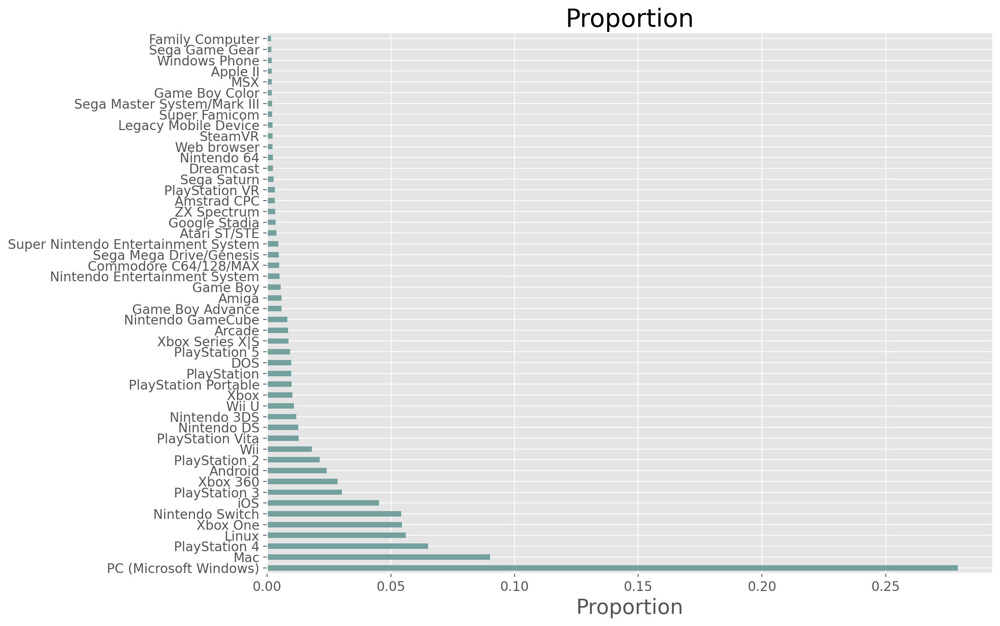

In [12]:
plot_proportions_for_top_n(df_ratings, col = 'platform_description', n = 50)

Seems like Windows games proportion (almost 30%) dominates in this dataset followed by Mac, PS4, Linux, Xbox One and Nintendo Switch.

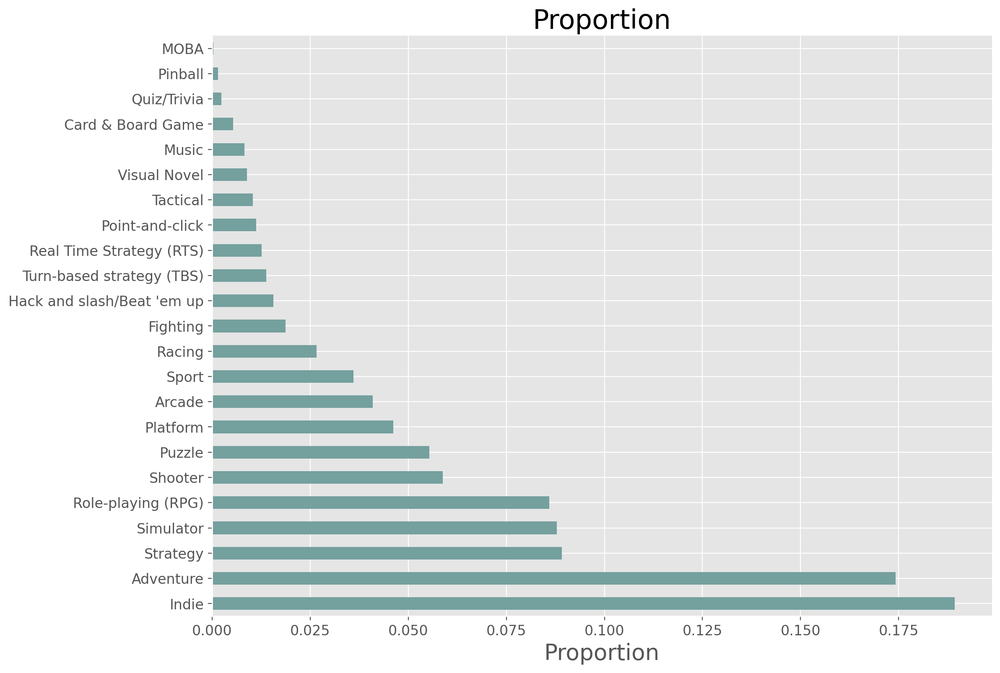

In [108]:
plot_proportions_for_top_n(df_ratings, col = 'genres_description', n = 30)

Most games here are categorized as Indie and Adventure genres.

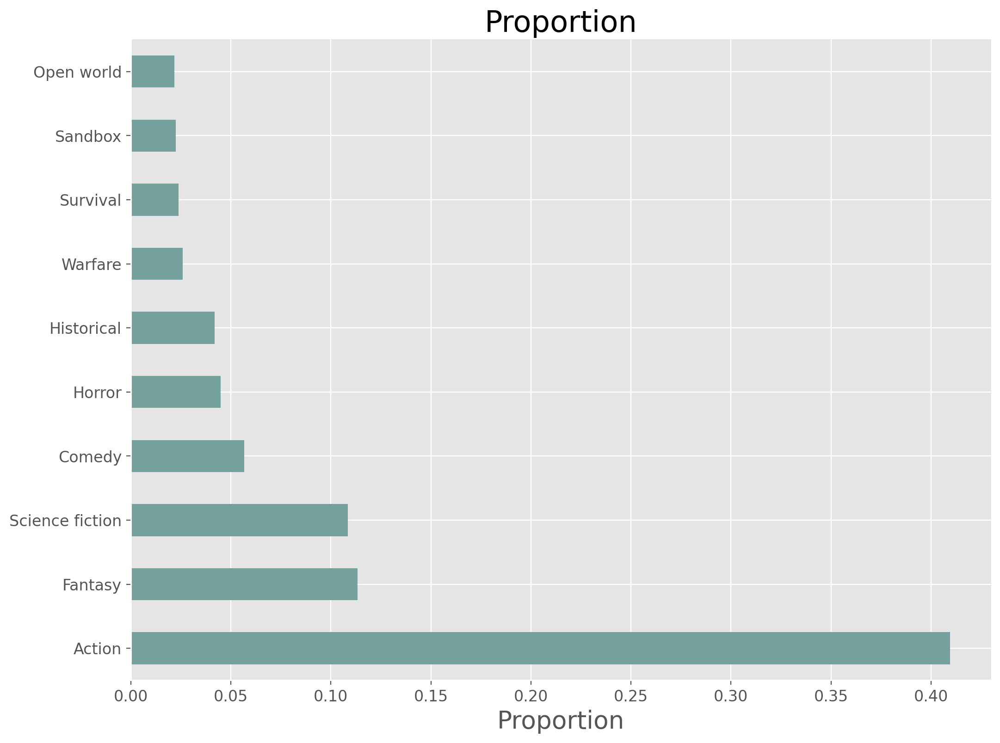

In [40]:
plot_proportions_for_top_n(df_ratings, col = 'themes_description', n = 10)

More than 40% of games are tagged with Action. The second most frequent theme is Fantasy which is not even close (only 12%).

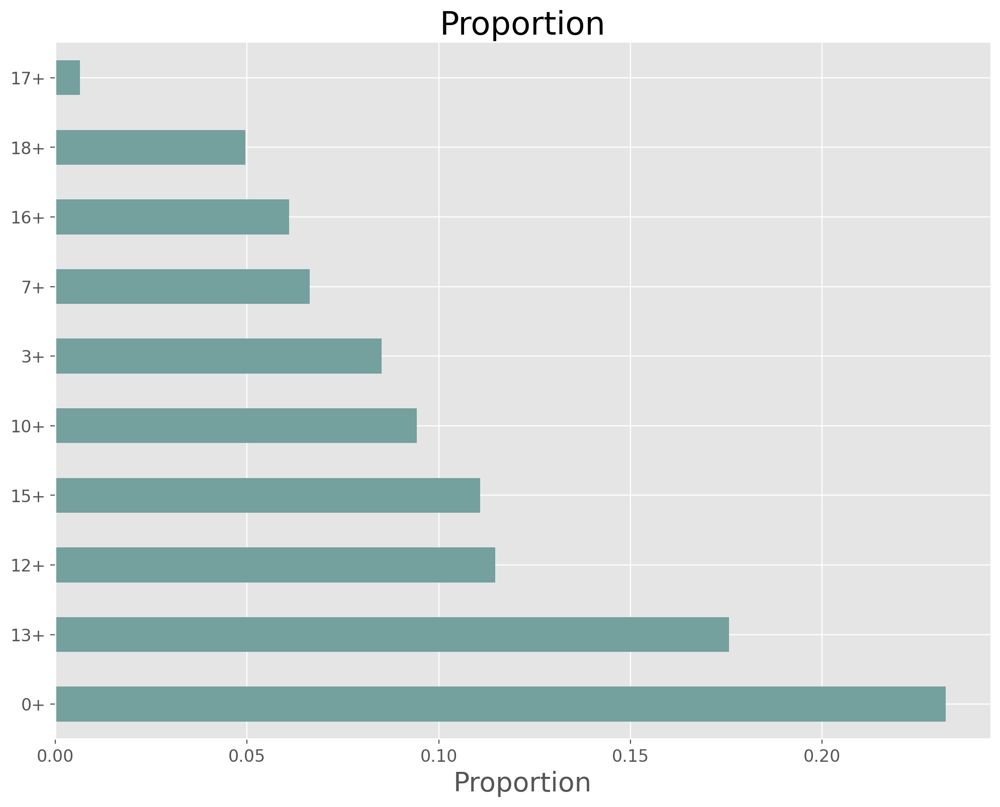

In [41]:
plot_proportions_for_top_n(df_ratings, col = 'age_group', n = 10)

Almost 25% of the games are for 0+. Mature games (16+, 17+, 18+) add up to only around 12% in the data.

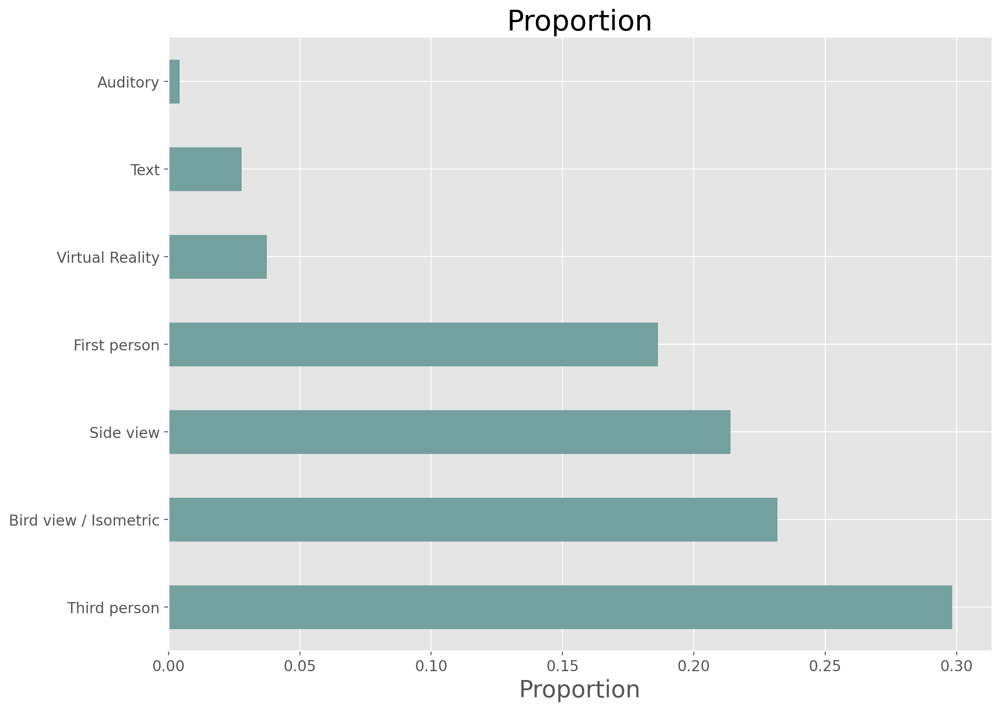

In [42]:
plot_proportions_for_top_n(df_ratings, col = 'player_perspectives_description', n = 7)

Almost 30% of the games have 3rd person view, 23% have top-down view, ~21% have side view (side scrolling games).

# 4. Bivariate Exploration

Coming to bivariate exploration, we will start by comparing the distributions among categories:

Because the histogram puts values into bins, it obscures some details. The CDF shows all unique values, so we can see where the exactly where each value falls.

Let's create KDE plots.

KDE is a way of getting from a PMF, a probability mass function, to a PDF, a probability density function. KDE may be more suitable for this than a PMF or CDF as total_rating has a lot of unique values.

In [13]:


def plot_kde(df  = df_ratings, col = 'platform_description', n = 10):
    """function to unpack the desired column and plot kernel density estimation plot for top n values

    Args:
        df (pandas.core.frame.DataFrame): dataframe that has the desired column. Defaults to df_ratings.
        col (str): column to unpack. Defaults to 'platform_description'.
        n (int): number of top values to plot. Defaults to 10.

    Returns:
        matplotlib plot: displays total_rating on x-axis and density on y-axis
    """
    
    df_exploded = df.apply(lambda x: x.explode() if x.name == col else x).reset_index()
    
    fig, ax = plt.subplots()
    name = "tab10"
    cmap = get_cmap(name)  # type: matplotlib.colors.ListedColormap
    colors = cmap.colors  # type: list
    ax.set_prop_cycle(color=colors)

    #df_exploded = df_exploded['platform_description_description'].value_counts().nlargest(10)
    # Extract the top unique categories based on count
    categories = df_exploded[col].value_counts().nlargest(n).index
    # Filter out 0 ratings
    over_0 = df_exploded[df_exploded['total_rating'] > 0]
    over_0 = over_0[over_0[col].isin(categories)]     
    
    sns.kdeplot(x='total_rating', data=over_0, hue=col, fill=False, legend=True, common_norm=False)
        
    ax.set(title='KDE Plot of Categories')
    

    return plt.show();

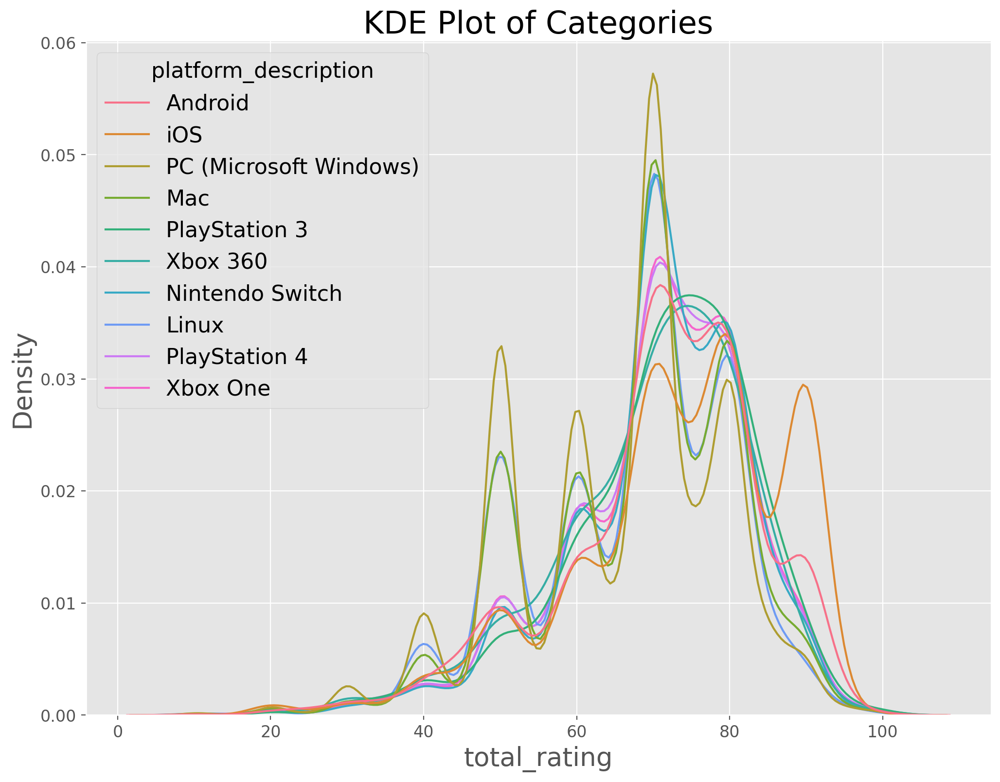

In [44]:
plot_kde(df  = df_ratings, col = 'platform_description', n = 10)

iOS games with a clear lead followed by android games have a higher rating than other platforms around 90s.
Xbox 360 and PS3 peak at above 75 and below 80 while others peak at 70.

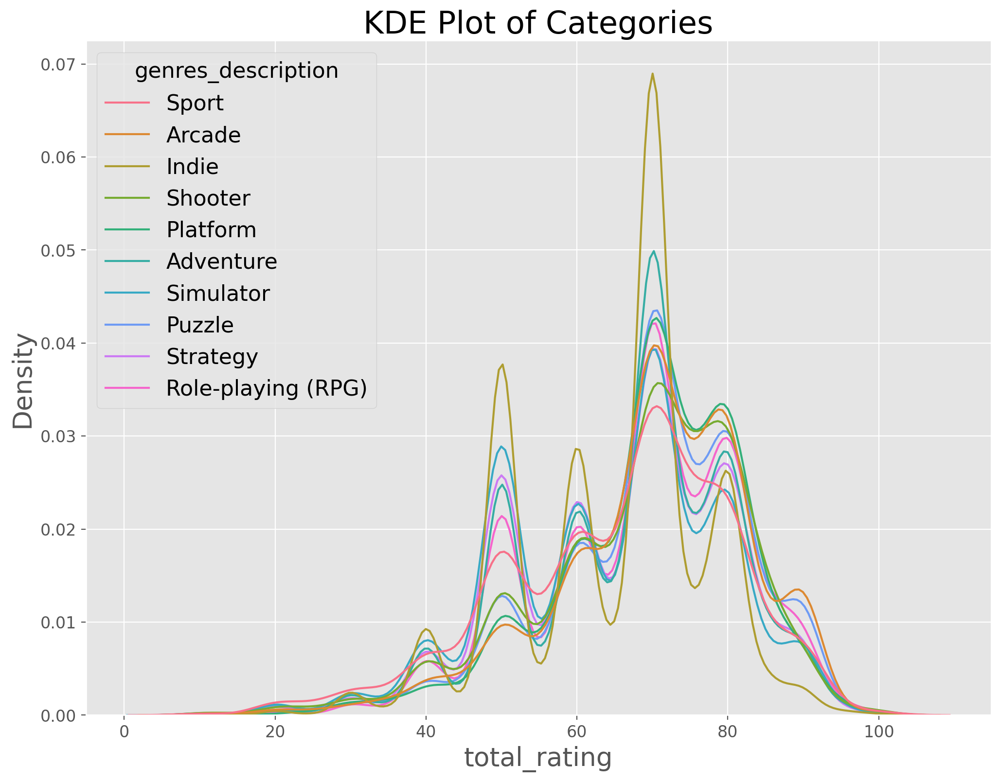

In [120]:
plot_kde(df  = df_ratings, col = 'genres_description', n = 10)

Arcade, puzzle and RPG games have more density compared to others around 90 (rating)

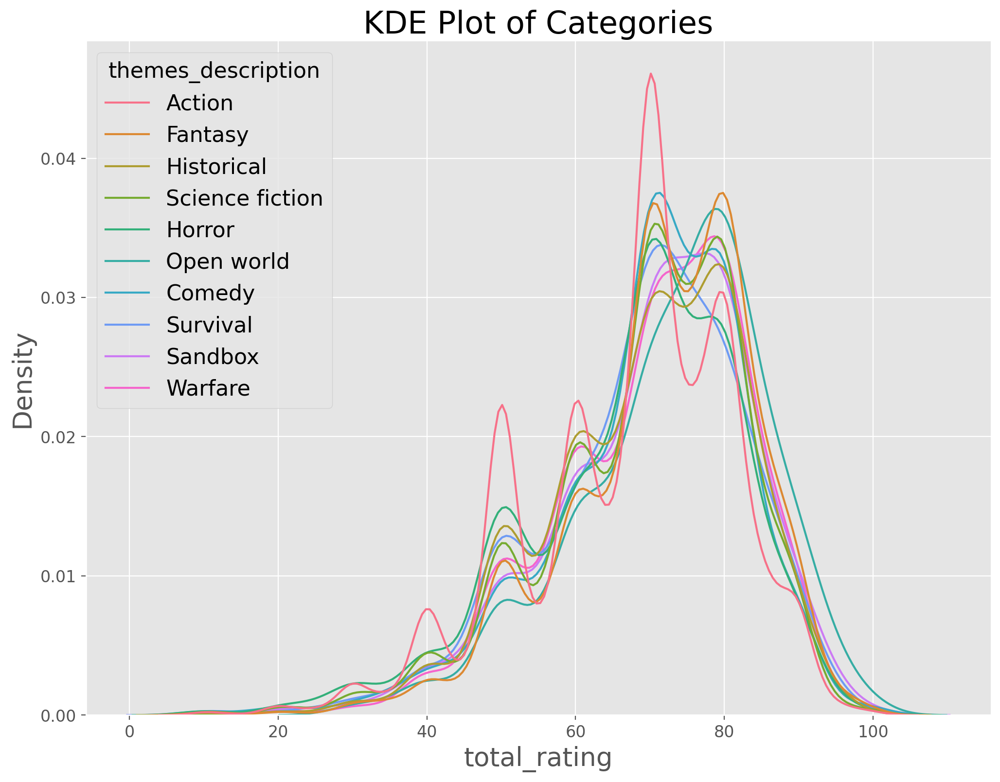

In [45]:
plot_kde(df  = df_ratings, col = 'themes_description', n = 10)

open world games have slightly higher density above 80s than any other theme.

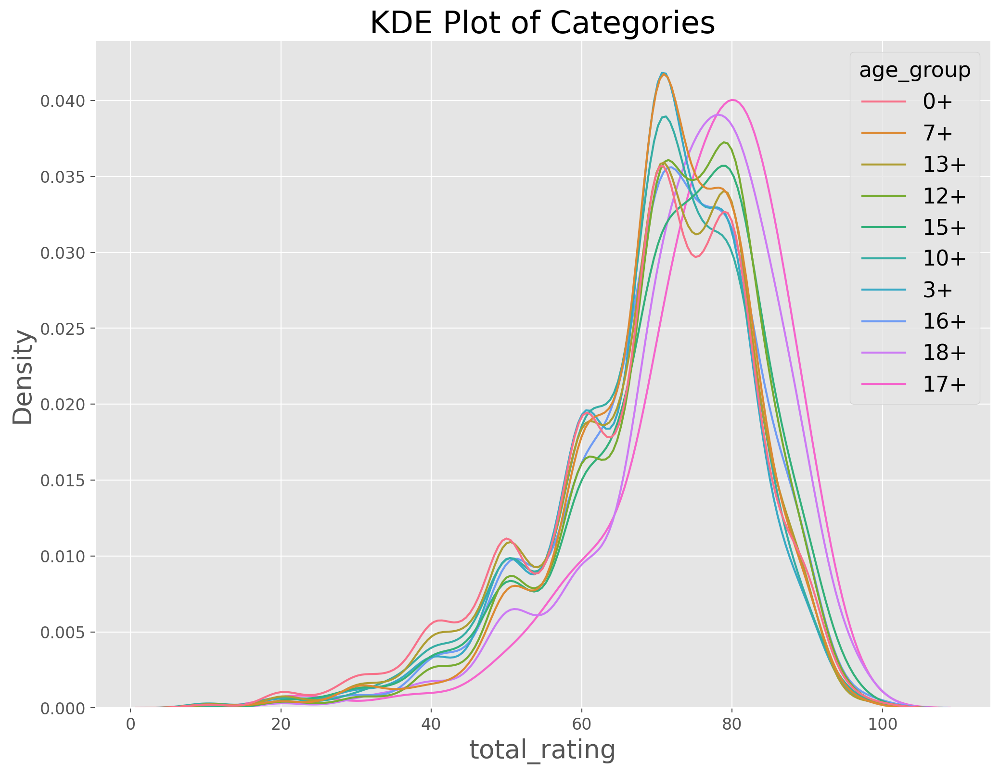

In [46]:
plot_kde(df  = df_ratings, col = 'age_group', n = 10)

Games that are age rated 'M' (or games that are for 17 or 18+) have more density at higher ratings.

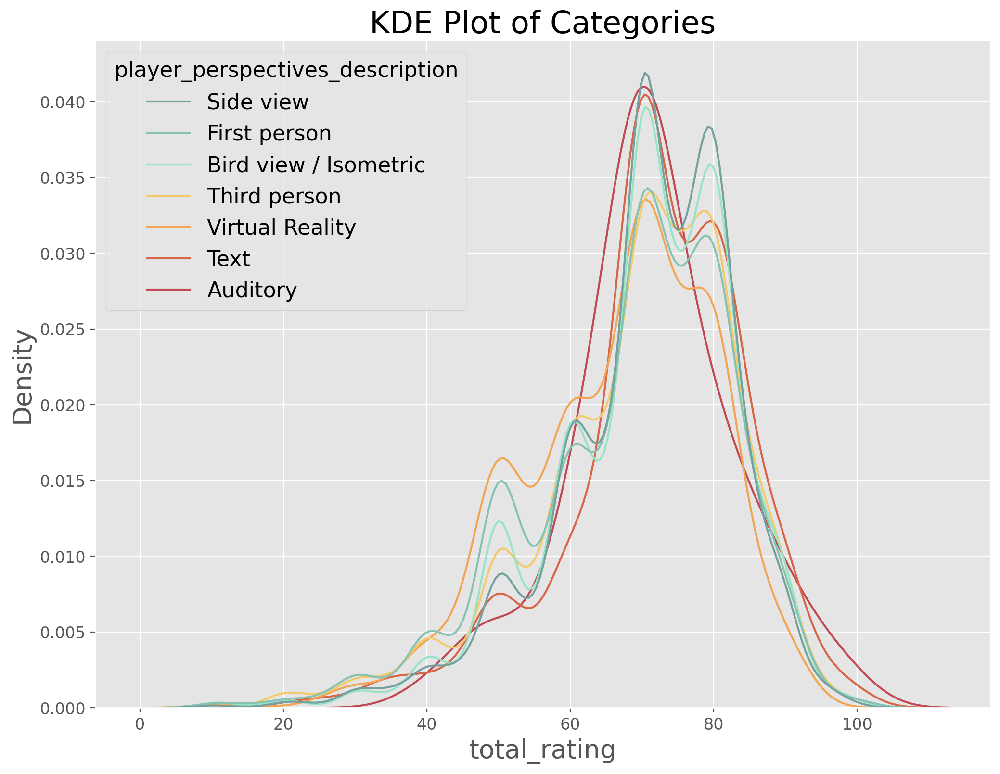

In [47]:
plot_kde(df  = df_ratings, col = 'player_perspectives_description', n = 10)

They all have the same distribution. Seems like the view does not matter for a game to have a high rating. VR games seem to have lowest densities above 70s and highest densities below 60s.

What would be interesting is to compare rating of the games across categories. Let's create boxplots. We can compare medians as box plots are not affected by skew in the ratings.

In [14]:
def boxplot_for_rating_across_categories(df = df_ratings, col = 'platform_description', hue_col = None, n = 10):
    """function to unpack the desired column and generate total_rating distribution box plot for top n values.
        Plot shows the highest median total_rating first regardless of hue.

    Args:
        df (pandas.core.frame.DataFrame): dataframe that has the desired columns. Defaults to df_ratings.
        col (str): column to unpack. Defaults to 'platform_description'.
        hue_col (str): column to be used for color encoding. Defaults to None.
        n (int): how many top values to show. Defaults to 10.

    Returns:
        _type_: _description_
    """

    df_exploded = df.apply(lambda x: x.explode() if x.name == col else x)

    categories = list(df_exploded[col].value_counts().nlargest(n).index)

    df_exploded = df_exploded[df_exploded[col].isin(categories)]
    
    ordered = df_exploded.groupby(col).median().sort_values(
    'total_rating', ascending=False).index

    fig, ax = plt.subplots()

    if(col == 'age_group'):
        sns.boxplot(x=col, y='total_rating', hue = hue_col, data=df_exploded, palette='husl',
                    order=["0+", "3+", "7+", "10+", "12+", "13+", "15+", "16+", "17+", "18+"])
    else:
        sns.boxplot(x=col, y='total_rating', hue = hue_col, data=df_exploded, palette='husl',
                    order = ordered)

    #ax.set_yscale('log')

    ax.set(title='Comparison of Ratings Between Categories',
        xlabel='', ylabel='Rating')

    # Rotate xtick labels
    ax.set_xticklabels(ax.get_xticklabels(), rotation=60)

    # Set custom yticklabels
    #y_ticks = [0.3, 0.5, 1, 3, 5, 10, 30, 100, 300]
    #ax.set_yticklabels(y_ticks)

    return plt.show();

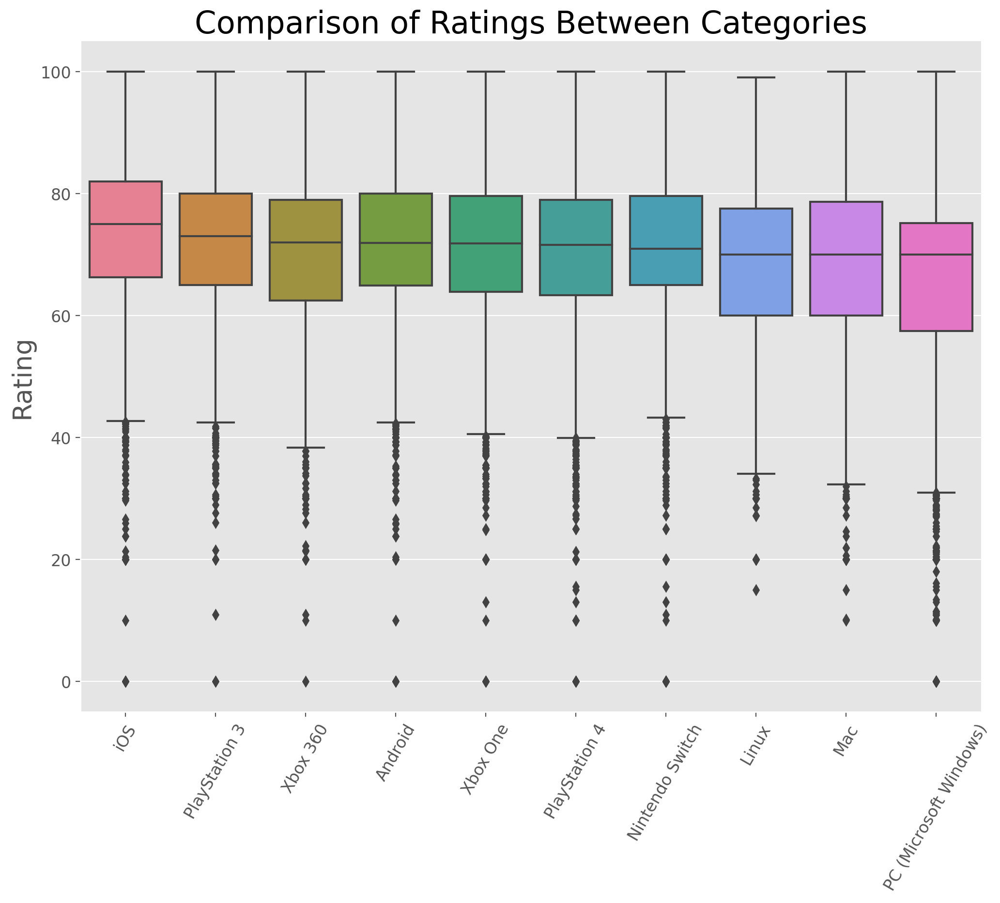

In [50]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'platform_description', n = 10)


##### With great moderation comes great quality!
- iOS games have higher median rating compared to other platforms. My theory is that mobile apps have a more targeted way of asking for ratings (we all have seen 'enjoying this game? Rate it!') and making it really easy for people to tap on 5 stars. We could argue that the same applies for Android too but why does Android have lower ratings relatively. This might be because iOS consumers spend far more per person than android users, making it a more appealing platform for developers to deliver better quality or it might be because android has to cater to thousands of phone models while iOS just needs to consider iphone and ipad models making it much simpler to develop and maintain games. Most importantly, Apple does have a great (and strict) moderation process that makes it harder for developers to push a bad quality app.

##### Surprising that 7th gen consoles have higher ratings than next gen consoles
- PS3 and Xbox 360 had bigger library of great games and they had backward compatibility while PS4 and Xbox One didn't. This may be one of the reasons why PS3 and Xbox 360 have slightly higher ratings than their next gen counterparts. Given that PS3 had a complicated developer kit for games, it seemed to have done really well.

##### Why do Linux and Mac games have higher ratings than Windows?
- Windows ranks slightly lower than Linux and Mac. This may be because of the inherent bias in the list of games. Most games are made for Windows and only the games that are successful or of great quality or from big franchises are made compatible with Linux and Mac. So Linux and Mac may have an edge over Windows when we try to compare ratings. Having said that, this is changing rapidly. Mac and Linux comaptible games are becoming increasingly common.

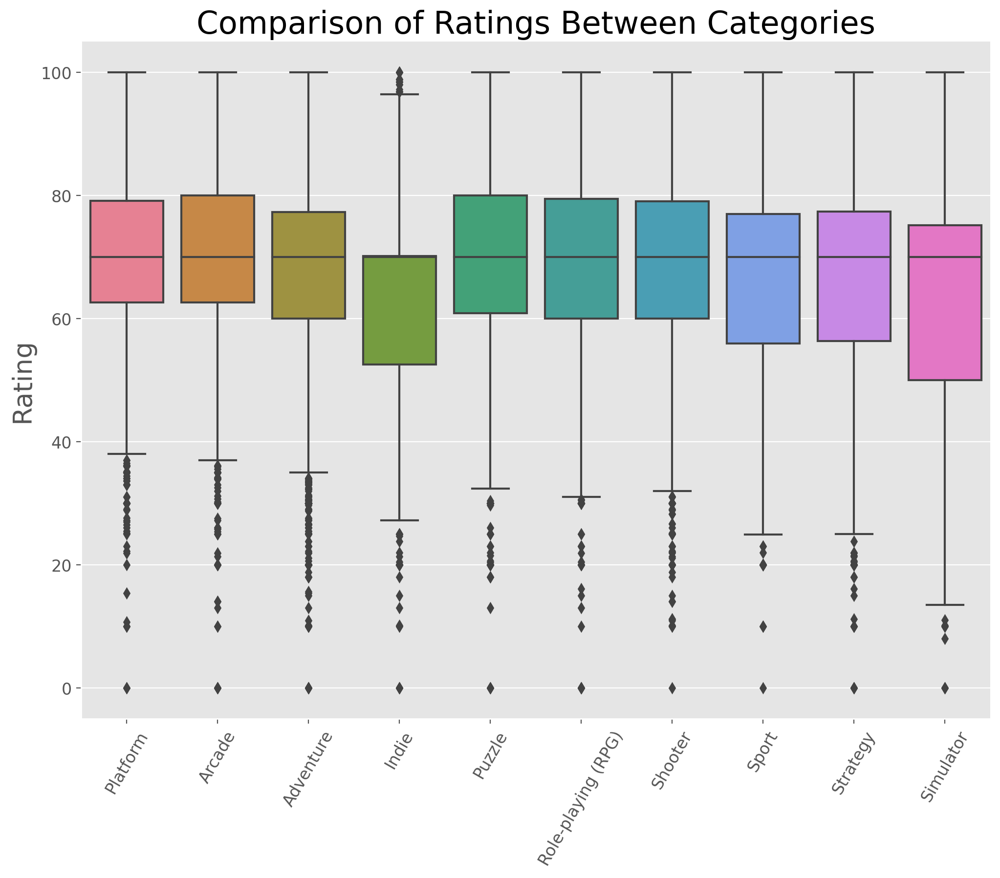

In [51]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'genres_description', n = 10)

Surprised to see how stable the median is regardless of a game genre. Simulator and Indie seem to have many lower ratings than other genres.

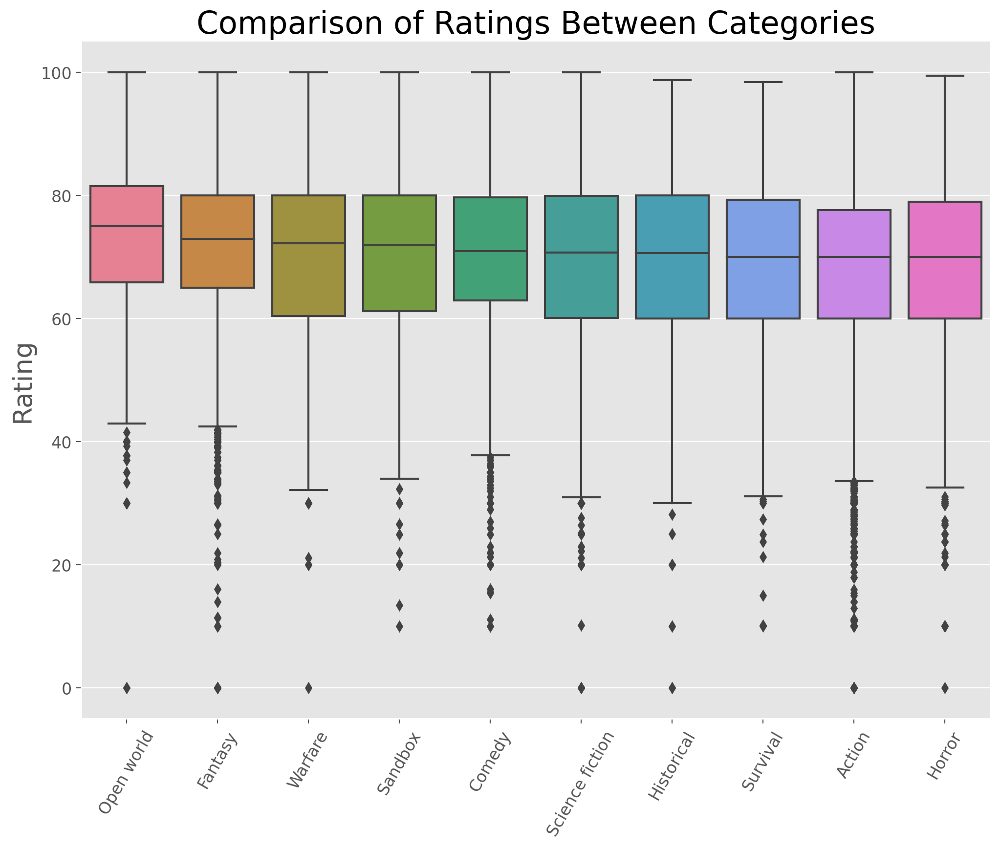

In [52]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'themes_description', n = 10)

Open world games clearly have higher rating distribution followed by Fantasy, Warfare and Sandbox. Seems like players love choice (Open world) and being to explore however they want to (Sandbox).

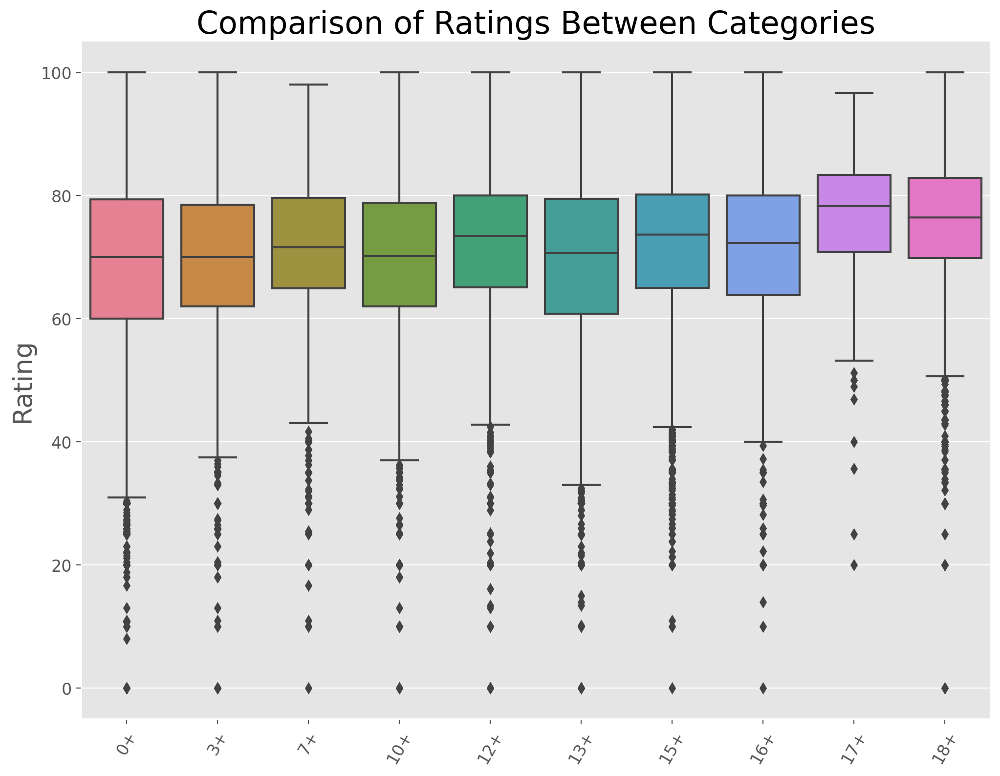

In [53]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'age_group', n = 10)

In general, games that have higher age requirement have higher ratings.

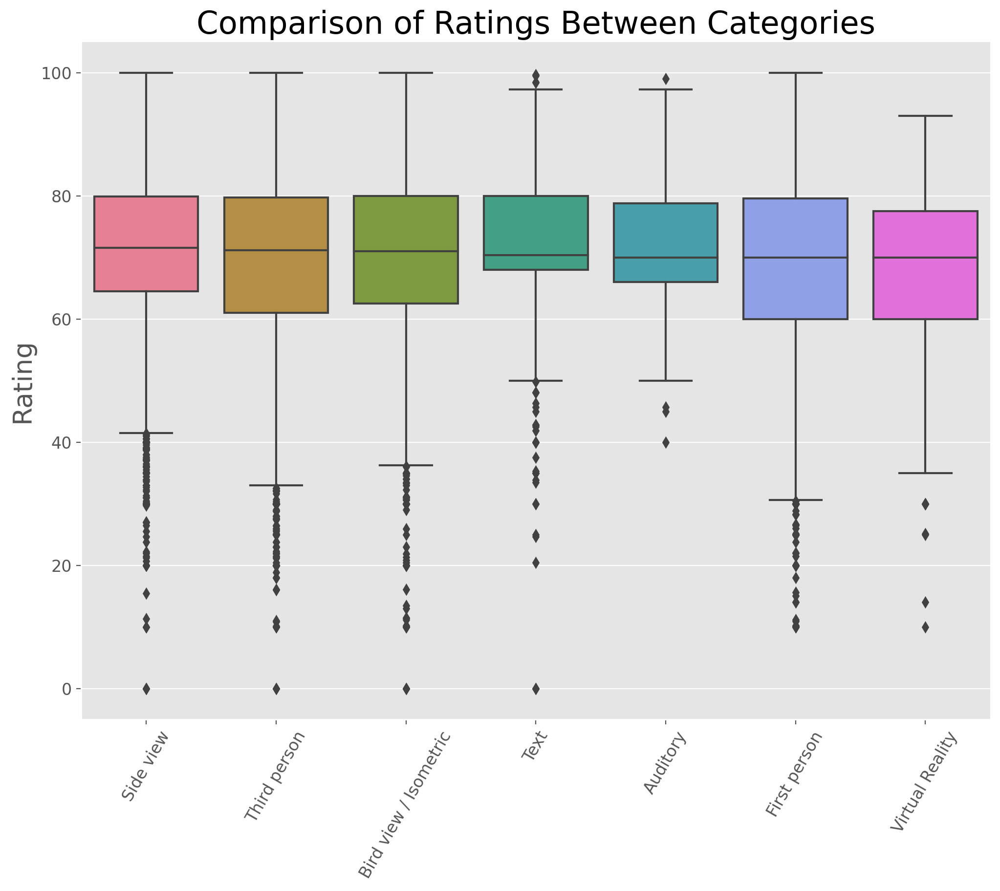

In [54]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'player_perspectives_description', n = 10)

Text and Auditory games have better IQRs but they are extremely few games in these groups relatively. Median-wise, player perspective in the game doesn't seem to matter.

Now, let's see if more ratings mean higher ratings.

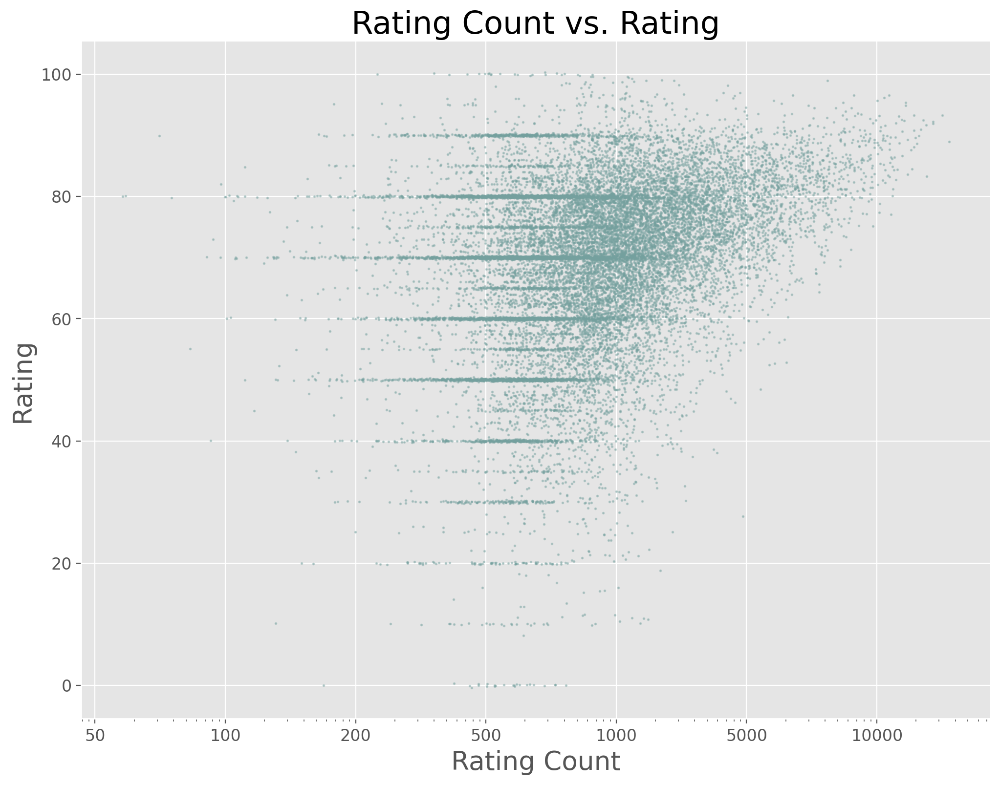

In [55]:
fig, ax = plt.subplots()

# Filter out 0 ratings
majority_rated = df_ratings[(df_ratings['total_rating_count'] > 0)]

# Jitter the ratings
rating_jittered = majority_rated['total_rating'] + np.random.normal(0, 0.12, len(majority_rated))
# Jitter the number of ratings
count_jittered = majority_rated['total_rating_count'] + np.random.normal(0, 1, len(majority_rated))

ax.plot(count_jittered, rating_jittered, 
        marker='o', linestyle='none', markersize=1, alpha=0.4)

# Use log scale
ax.set_xscale('log')
# Set custom tick labels
x_tick_labels = [1, 10, 50, 100, 200, 500, 1000, 5000, 10000, 50000, 100000]
ax.set_xticklabels(x_tick_labels)

# Label
ax.set(title='Rating Count vs. Rating',
       xlabel='Rating Count', 
       ylabel='Rating')

plt.show();

The graph appears to have a logarithmic curve. Although it may be weak, as the no. of ratings increase, the rating is higher.

We can check this by plotting a correlation matrix:

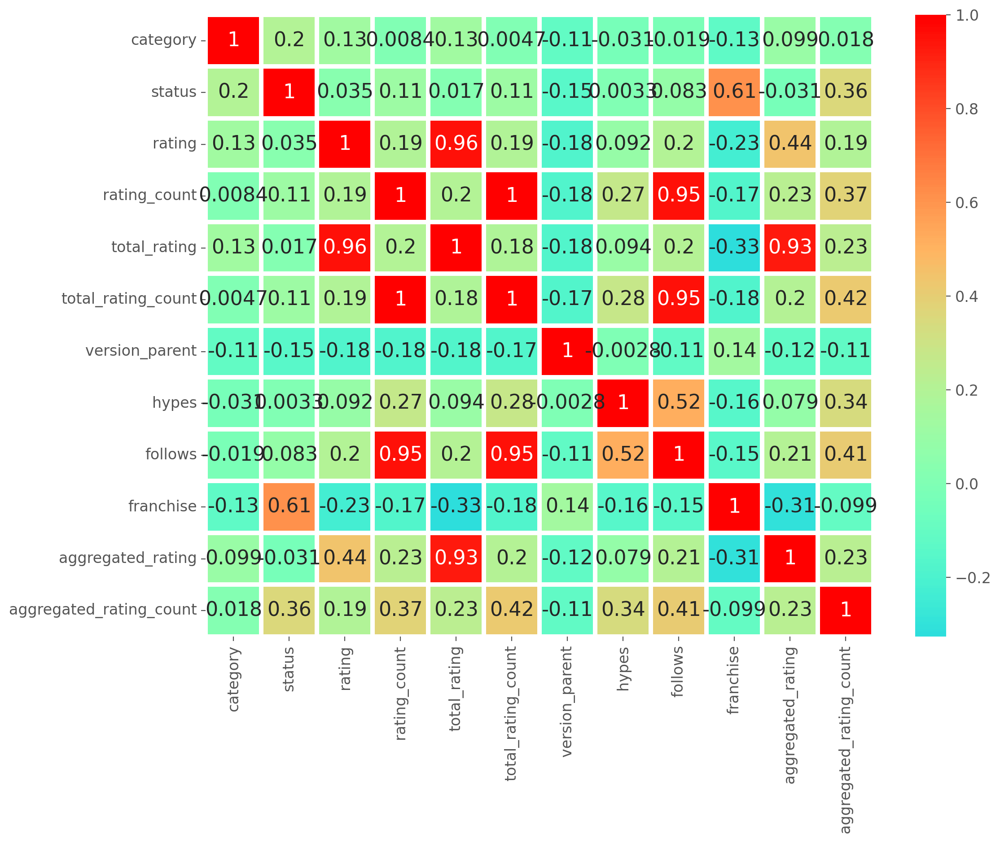

In [56]:
sns.heatmap(df_ratings.corr(), annot=True, 
            linewidths=3, center=0, cmap='rainbow');

Correlation matrix does not tell us much. We only see a correlation coefficient of 0.18 for total_rating and tota_rating_count.

What's interesting is that follows and hype do not seem to have any siginificant correlation with how successful (total_rating) a game is.

Let's plot a simplfied correlation matrix and see any weak, medium or strong correlations between numerical features.

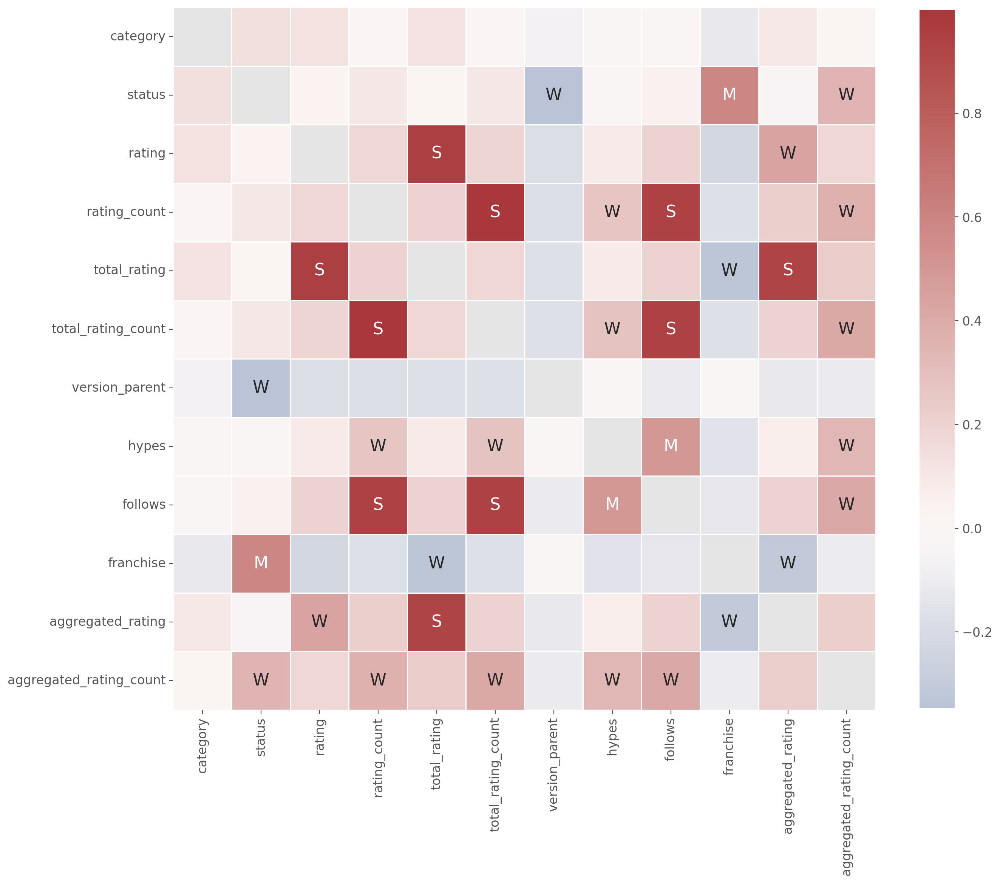

In [57]:
# Computes feature correlation
df_corr = df.corr(method="pearson")

# Create labels for the correlation matrix
labels = np.where(np.abs(df_corr)>0.75, "S",
                  np.where(np.abs(df_corr)>0.5, "M",
                           np.where(np.abs(df_corr)>0.25, "W", "")))

# Plot correlation matrix
plt.figure(figsize=(15, 15))
sns.heatmap(df_corr, mask=np.eye(len(df_corr)), square=True,
            center=0, annot=labels, fmt='', linewidths=.5,
            cmap="vlag", cbar_kws={"shrink": 0.8});

- total_rating_count has a strong positive correlation with number of follows.
- number of hypes has weak positive correlation with number of ratings and a medium positive correlation with the number of follows.
- franchise is just a numeric code and it's correlations are not useful here.

Let's do a pair plot to focus on interesting columns!

Text(0.5, 2386.924603174603, '')

Text(71.22189484126983, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'log_follows')

Text(876.063209974353, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'log_hypes')

Text(1260.1158119853387, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'follows')

Text(2028.2210160073107, 0.5, 'total_rating')

Text(0.5, 2386.924603174603, 'hypes')

Text(2412.2736180182965, 0.5, 'total_rating')

Text(0.5, 2003.2658730158732, 'total_rating')

Text(76.59689484126983, 0.5, 'log_total_rating_count')

Text(0.5, 2003.2658730158732, '')

Text(492.0106079633669, 0.5, '')

Text(0.5, 2003.2658730158732, 'log_follows')

Text(876.063209974353, 0.5, 'log_total_rating_count')

Text(0.5, 2003.2658730158732, 'log_hypes')

Text(1260.1158119853387, 0.5, 'log_total_rating_count')

Text(0.5, 2003.2658730158732, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'log_total_rating_count')

Text(0.5, 2003.2658730158732, 'follows')

Text(2028.2210160073107, 0.5, 'log_total_rating_count')

Text(0.5, 2003.2658730158732, 'hypes')

Text(2412.2736180182965, 0.5, 'log_total_rating_count')

Text(0.5, 1619.6071428571431, 'total_rating')

Text(76.59689484126983, 0.5, 'log_follows')

Text(0.5, 1619.6071428571431, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'log_follows')

Text(0.5, 1619.6071428571431, '')

Text(876.063209974353, 0.5, '')

Text(0.5, 1619.6071428571431, 'log_hypes')

Text(1260.1158119853387, 0.5, 'log_follows')

Text(0.5, 1619.6071428571431, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'log_follows')

Text(0.5, 1619.6071428571431, 'follows')

Text(2028.2210160073107, 0.5, 'log_follows')

Text(0.5, 1619.6071428571431, 'hypes')

Text(2412.2736180182965, 0.5, 'log_follows')

Text(0.5, 1235.948412698413, 'total_rating')

Text(76.59689484126983, 0.5, 'log_hypes')

Text(0.5, 1235.948412698413, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'log_hypes')

Text(0.5, 1235.948412698413, 'log_follows')

Text(876.063209974353, 0.5, 'log_hypes')

Text(0.5, 1235.948412698413, '')

Text(1260.1158119853387, 0.5, '')

Text(0.5, 1235.948412698413, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'log_hypes')

Text(0.5, 1235.948412698413, 'follows')

Text(2028.2210160073107, 0.5, 'log_hypes')

Text(0.5, 1235.948412698413, 'hypes')

Text(2412.2736180182965, 0.5, 'log_hypes')

Text(0.5, 852.2896825396828, 'total_rating')

Text(60.59689484126983, 0.5, 'total_rating_count')

Text(0.5, 852.2896825396828, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'total_rating_count')

Text(0.5, 852.2896825396828, 'log_follows')

Text(876.063209974353, 0.5, 'total_rating_count')

Text(0.5, 852.2896825396828, 'log_hypes')

Text(1260.1158119853387, 0.5, 'total_rating_count')

Text(0.5, 852.2896825396828, '')

Text(1644.1684139963247, 0.5, '')

Text(0.5, 852.2896825396828, 'follows')

Text(2028.2210160073107, 0.5, 'total_rating_count')

Text(0.5, 852.2896825396828, 'hypes')

Text(2412.2736180182965, 0.5, 'total_rating_count')

Text(0.5, 468.63095238095235, 'total_rating')

Text(60.59689484126983, 0.5, 'follows')

Text(0.5, 468.63095238095235, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'follows')

Text(0.5, 468.63095238095235, 'log_follows')

Text(876.063209974353, 0.5, 'follows')

Text(0.5, 468.63095238095235, 'log_hypes')

Text(1260.1158119853387, 0.5, 'follows')

Text(0.5, 468.63095238095235, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'follows')

Text(0.5, 468.63095238095235, '')

Text(2028.2210160073107, 0.5, '')

Text(0.5, 468.63095238095235, 'hypes')

Text(2412.2736180182965, 0.5, 'follows')

Text(0.5, 65.11111111111083, 'total_rating')

Text(60.59689484126983, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'log_total_rating_count')

Text(492.0106079633669, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'log_follows')

Text(876.063209974353, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'log_hypes')

Text(1260.1158119853387, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'total_rating_count')

Text(1644.1684139963247, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'follows')

Text(2028.2210160073107, 0.5, 'hypes')

Text(0.5, 65.11111111111083, 'hypes')

Text(2412.2736180182965, 0.5, '')

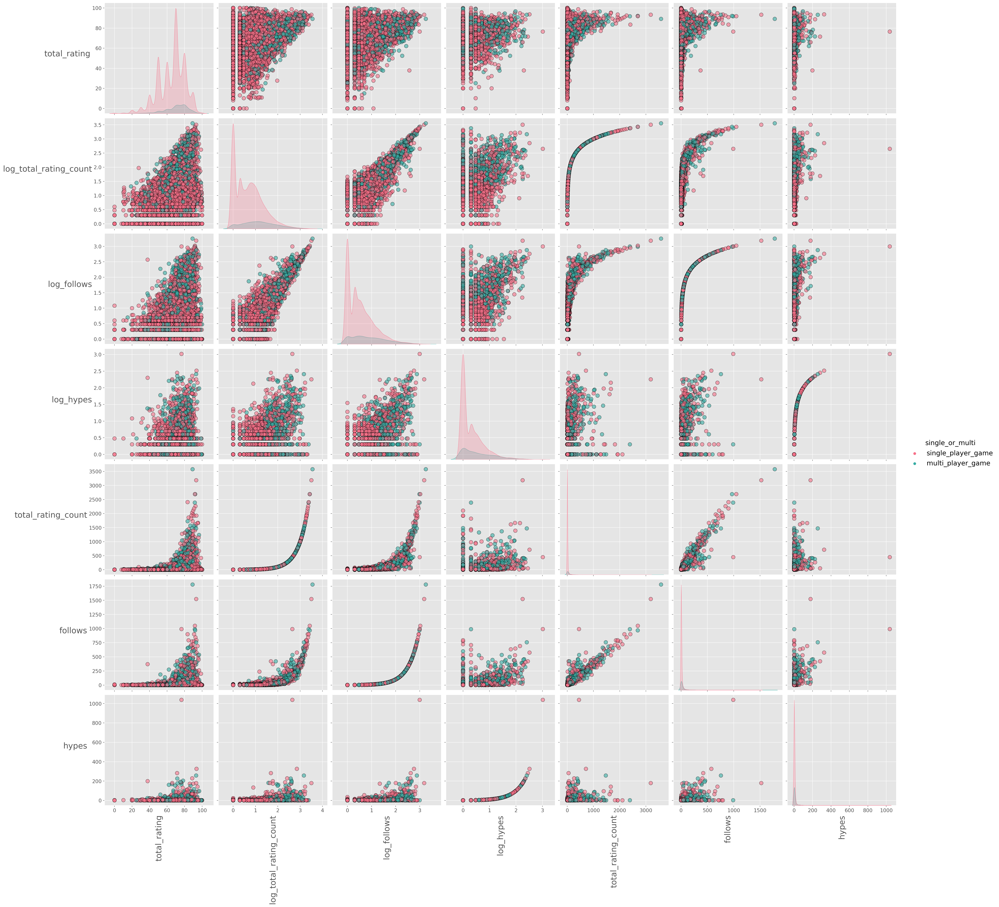

In [15]:

#adding a flag to indicate whether the game is a multiplayer or not
df_ratings['single_or_multi'] = np.where(df_ratings['multiplayer_modes'].isna(), 'single_player_game', 'multi_player_game')

# Take the log of hypes, follows and total_rating_count as they are extremely right skewed
df_ratings['log_hypes'] = np.log10(df_ratings['hypes'])
df_ratings['log_follows'] = np.log10(df_ratings['follows'])
df_ratings['log_total_rating_count'] = np.log10(df_ratings['total_rating_count'])

g = sns.pairplot(df_ratings, vars = ['total_rating','log_total_rating_count','log_follows','log_hypes','total_rating_count', 'follows', 'hypes'],
                 dropna = True, diag_kind = 'kde', size = 4, hue = 'single_or_multi', palette='husl',
                 plot_kws = {'alpha': 0.6, 's': 80, 'edgecolor': 'k'}
                 ) #plot_kws={"s": 2, "alpha": 0.2}); # plot_kws = {'line_kws':{'alpha': 0.2, 's':80, 'color':'red'}}
# Rotate xtick labels
for ax in g.axes.flatten():
    # rotate x axis labels
    ax.set_xlabel(ax.get_xlabel(), rotation = 90)
    # rotate y axis labels
    ax.set_ylabel(ax.get_ylabel(), rotation = 0)
    # set y labels alignment
    ax.yaxis.get_label().set_horizontalalignment('right')

Based on this, games may have slightly higher ratings if more people have rated them (total_rating_count).

It is hard to say from this but Hype around the game or number of follows don't seem to have a strong relationship with higher rating score which is surprising.

- Hypes = no of follows to a game before release
- Follows = no of follows to a game after release

Hypes and Follows have a positive correlation as expected. We can observe that in some cases, games with less hypes (follows before release) may have more no. of follows (after release) but games with less follows do not have as many hypes relatively.

Similarly, as more people follow a game, more people rate it (total_rating_count).

Now, let's explore other angles. We will look at no. of single player and multi player games in each platform.

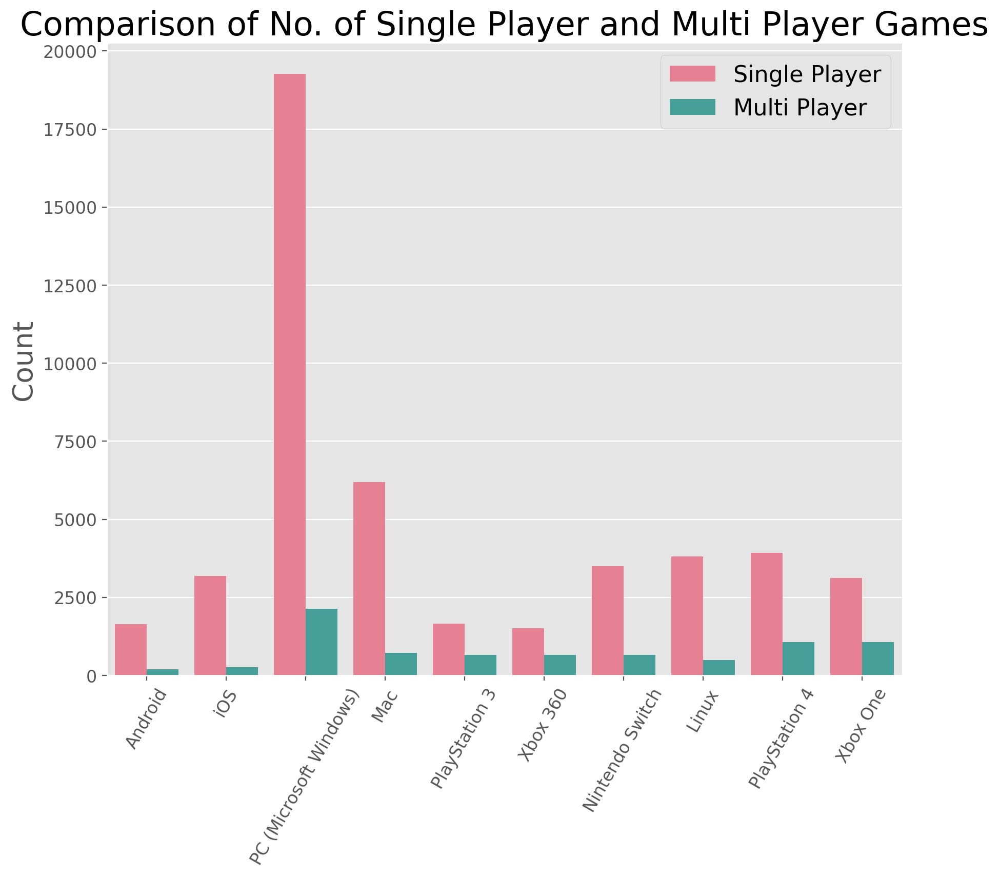

In [16]:
fig, ax = plt.subplots(figsize=(10, 8))
df_exploded = df_ratings.apply(lambda x: x.explode() if x.name == 'platform_description' else x)

categories = list(df_exploded['platform_description'].value_counts().nlargest(10).index)

sns.countplot(x='platform_description', hue='single_or_multi', data=df_exploded[df_exploded['platform_description'].isin(categories)],
              palette='husl')#['#74a09e','#f2a553']

ax.legend(['Single Player', 'Multi Player'], loc='upper right')
# Rotate xtick labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=60)

ax.set(title='Comparison of No. of Single Player and Multi Player Games',
       xlabel='', ylabel='Count')

plt.show();

Not all games for all platforms are captured in this dataset. PS3 and Xbox 360 had 3 times more games than the ones listed here (< 2500 shown in data here).

# 5. Multivariate Exploration

Let us see how rating distribution is for single player and multi player games for platforms, genres, themes, age groups and player perspectives. 

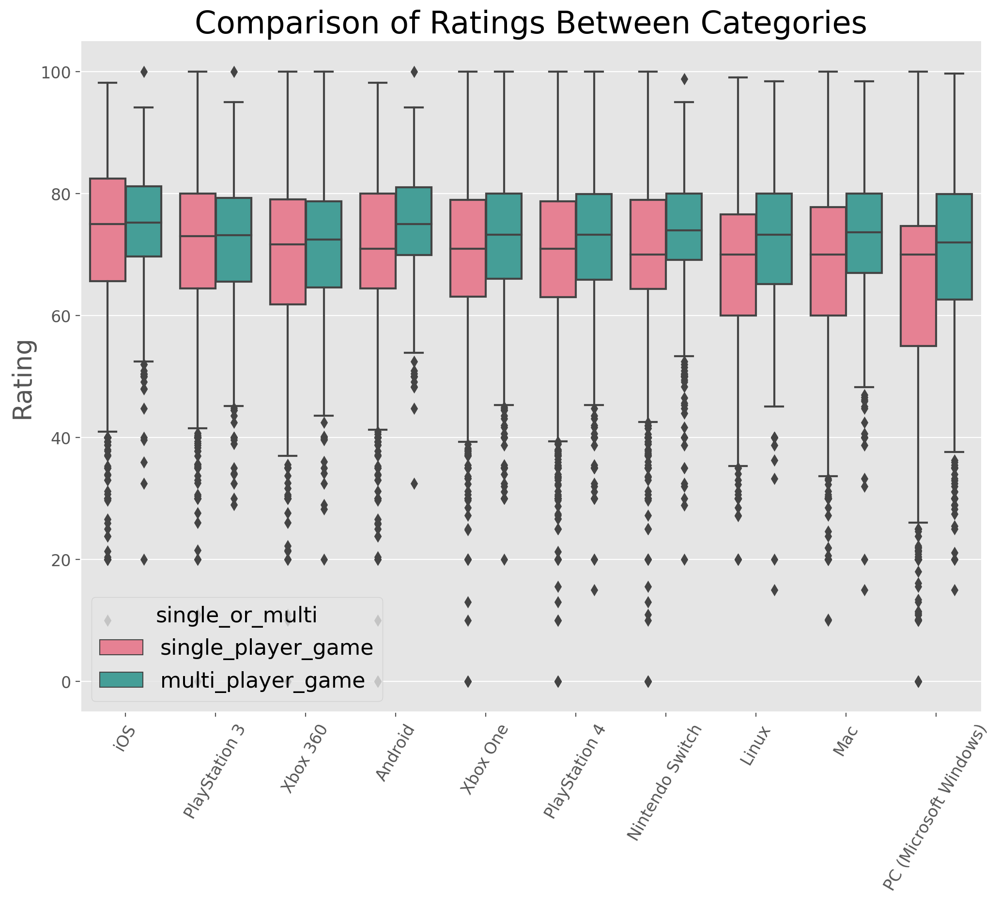

In [17]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'platform_description', hue_col = 'single_or_multi', n = 10)

Multi player games have better rating scores than single player games. This may be because of several reasons. Multiplayer games are more profitable and thus have the need to create a great experience to support thousands or millions of gamers. Gamers spend more time and money on multi player games (replay value) than single player preferring gamers. Although there are a lot of people who love single player games, there are people who prefer playing games with each other than alone and they love competition (social creatures by nature). This doesn't mean single player games are bad. It's just that on ratings comparison multi player games do a little better.

While all platforms have multi player games rated higher than single player games, Mac, Android and Nintendo Switch multi player games have a significantly higher rating distribution than that of the single player games.



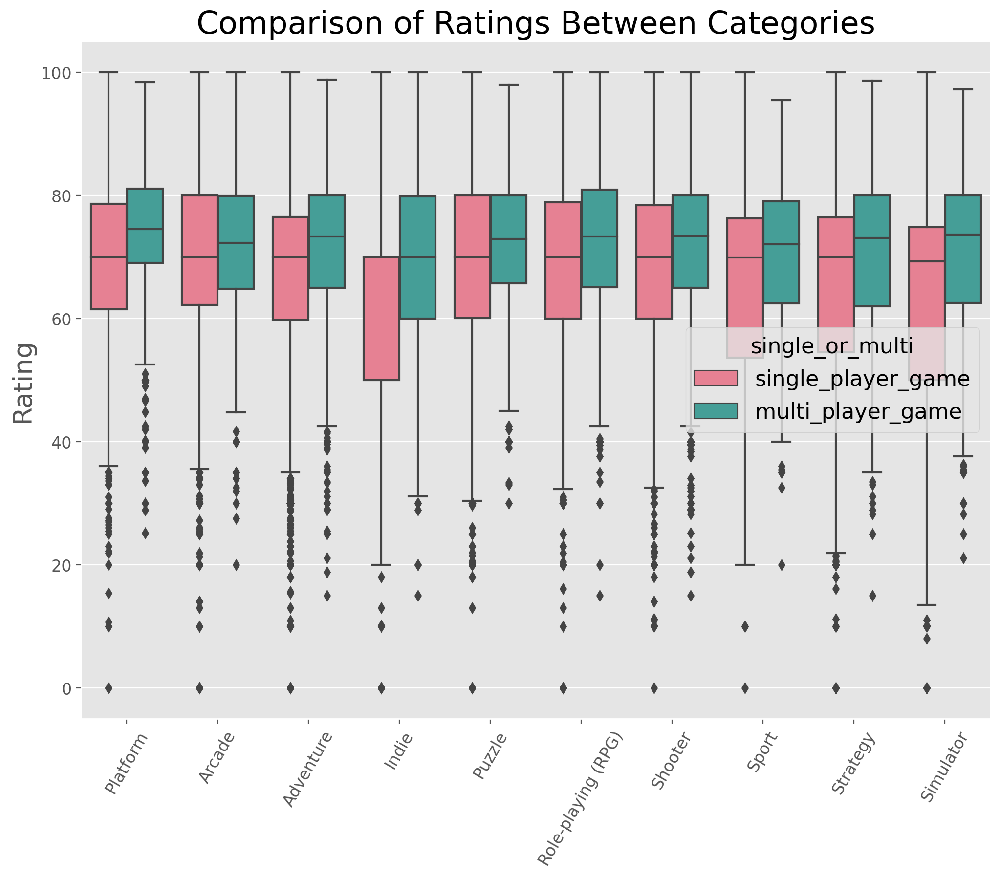

In [62]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'genres_description', hue_col = 'single_or_multi', n = 10)

Indie and Simulator genres seem to have much better rating distribution for multi player games than single player games. For single player games, genre doesn't matter much as all of the have almost the same median.

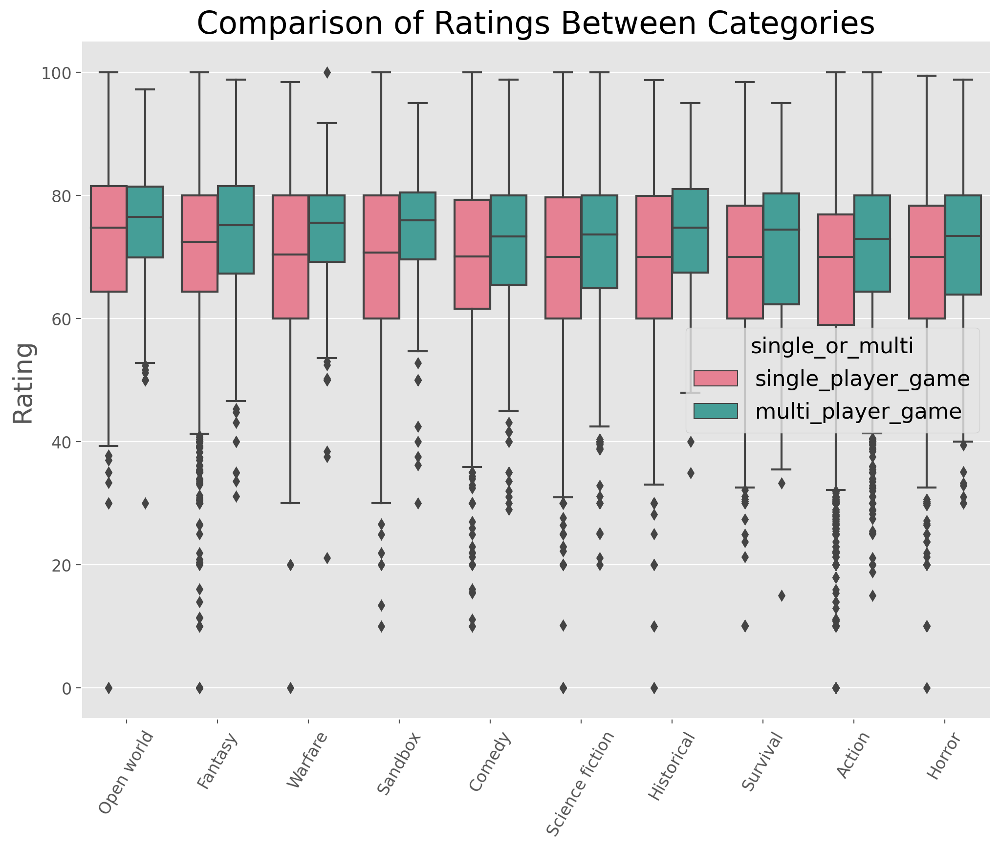

In [63]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'themes_description', hue_col = 'single_or_multi', n = 10)

Multi player games have better rating in all themes. Fantasy and Open World themes have higher ratings among single player games,  while Sandbox, Open world and Warfare have higher ratings among multi player games.

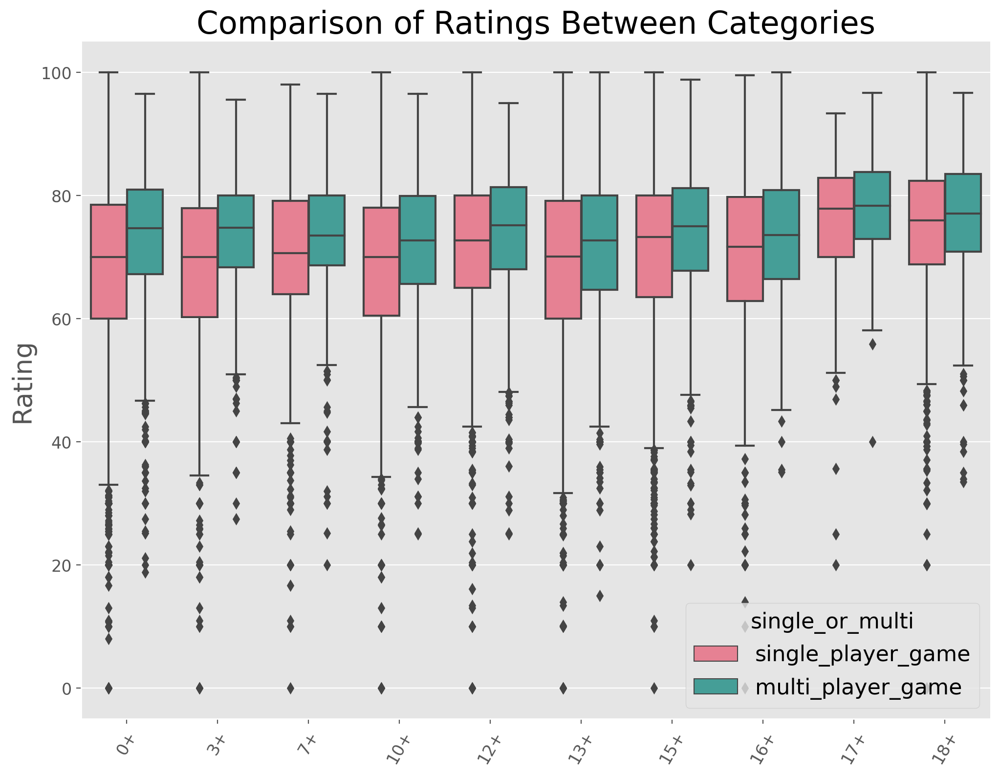

In [64]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'age_group', hue_col = 'single_or_multi', n = 10)

The rating distribution gap between single player and multi player games seems to decrease as the age increases. Gap is wider for 0+ and 3+ while it is narrow for 17+ and 18+ groups.

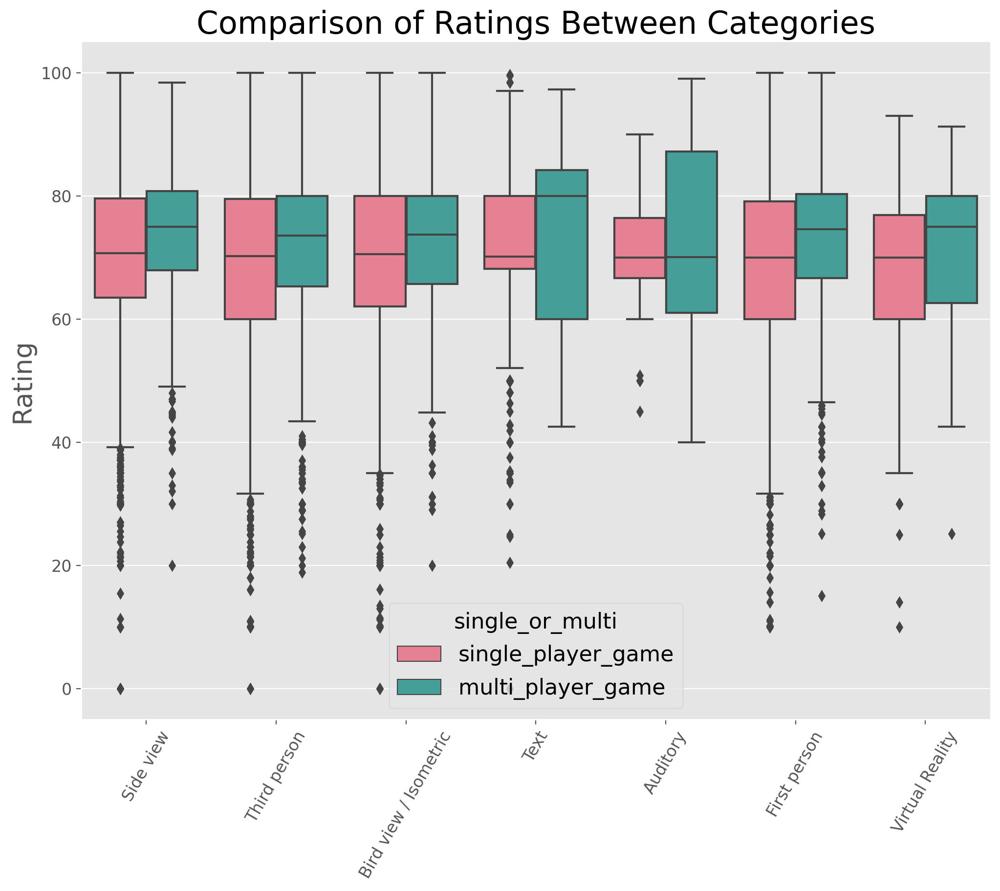

In [65]:
boxplot_for_rating_across_categories(df = df_ratings, col = 'player_perspectives_description', hue_col = 'single_or_multi', n = 10)

Interesting to see that text based (interactive fiction) multi player games seem to have relatively higher rating distribution even though they are not popular (they constitute less than 5% of the total proportion as we have seen above). Only in Auditory (note that there are only a few games in this group), we see the same median rating for single and multiplayer games while in the rest, multiplayer games rating is much better.

Let's clean the columns a bit.

age_group in the current form doesn't make much sense as each game has multiple age group values. 0+, 12+ can be interpreted in the same way as 0+.
Let's take only the first age limit value from the age_group column and re-categorize them into 3 major groups - Everyone, Teen, Mature for our analysis

Similarly, although genres and themes have multiple categories, let's just take the first primary category in these columns for convenience. For example, a game may belong to fighting, hack and slash, adventure categories but let us just consider it as a fighting game to simplify analysis.

Instead of choosing the first category, all the columns could be unnested (exploded) but that would just make total_rating to be repeated multiple times changing rating distribution and may be inaccurate for drawing any insight.

In [18]:
df_cleaned = df_ratings.copy()

df_cleaned['age_group_clean'] = df_cleaned['age_group'].str[0]

#re-grouping age groups
df_cleaned['age_group_clean'] = df_cleaned['age_group_clean'].replace(['0+', '3+', '7+', '10+'], 'Everyone')
df_cleaned['age_group_clean'] = df_cleaned['age_group_clean'].replace(['12+', '13+', '14+', '15+'], 'Teen')
df_cleaned['age_group_clean'] = df_cleaned['age_group_clean'].replace(['16+', '17+', '18+'], 'Mature')

df_cleaned['genres_description_clean'] = df_cleaned['genres_description'].str[0]
df_cleaned['themes_description_clean'] = df_cleaned['themes_description'].str[0]
df_cleaned['player_perspectives_clean'] = df_cleaned['player_perspectives_description'].str[0]


df_cleaned['release_year'] = pd.DatetimeIndex(df_cleaned['first_release_date']).year

Let's look at games released after 2011 and exclude zero ratings this time.

In [33]:
# Let's unpack this df based on platforms
df_cleaned_exploded = df_cleaned.apply(lambda x: x.explode() if x.name == 'platform_description' else x).reset_index()

# Consider top categories. Too many categories will not be useful.
platform_categories = list(df_cleaned_exploded['platform_description'].value_counts().nlargest(10).index)
genres_categories = list(df_cleaned_exploded['genres_description_clean'].value_counts().nlargest(10).index)
themes_categories = list(df_cleaned_exploded['themes_description_clean'].value_counts().nlargest(10).index)
age_categories = list(df_cleaned_exploded['age_group_clean'].value_counts().nlargest(3).index)
player_perspectives_categories = list(df_cleaned_exploded['player_perspectives_clean'].value_counts().nlargest(10).index)


# Filtering the data for only top categories in each column
df_cleaned_exploded = df_cleaned_exploded[(df_cleaned_exploded['total_rating'] > 0) &
                                          (df_cleaned_exploded['platform_description'].isin(platform_categories)) &
                                          (df_cleaned_exploded['genres_description_clean'].isin(genres_categories)) &
                                          (df_cleaned_exploded['themes_description_clean'].isin(themes_categories)) &
                                          (df_cleaned_exploded['age_group_clean'].isin(age_categories))]

# For over the time trends, filtering for release_year >2011
df_cleaned_exploded_2012_2022 = df_cleaned_exploded[(df_cleaned_exploded['release_year'] > 2011)]


### How do the ratings vary year by year?

In [36]:
def boxplot_for_rating_by_cat(df = df_cleaned_exploded_2012_2022, x = 'release_year', y = 'total_rating',
                              hue = None, col = 'platform_description'):
    """function to generate multiple boxplots for total_rating based on the chosen columns

    Args:
        df (pandas.core.frame.DataFrame): dataframe. Defaults to df_cleaned_exploded.
        x (str): x-axis feature. Defaults to 'release_year'.
        y (str): y-axis feature. Defaults to 'total_rating'.
        hue (str): column for color encoding. Defaults to None.
        col (str): column that has a group for each of the boxplot. Defaults to 'platform_description'.        
    """
    g = sns.catplot(
        x=x, 
        y=y, 
        data=df,
        palette='husl',
        height=3, aspect=1.5,
        kind='box', 
        hue=hue,
        col=col,
        col_wrap=2)
    g.set_titles(
    '{col_name}');
    g.set_xticklabels(
    rotation=45, ha='right')

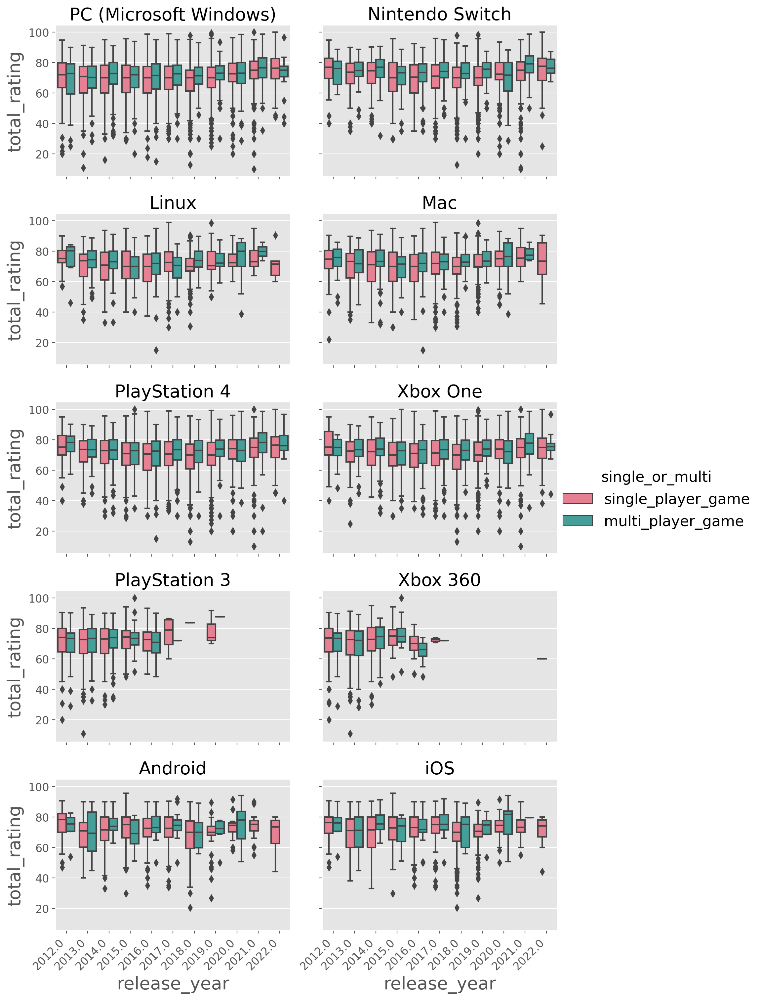

In [37]:
boxplot_for_rating_by_cat(x = 'release_year', hue = 'single_or_multi', col = 'platform_description')

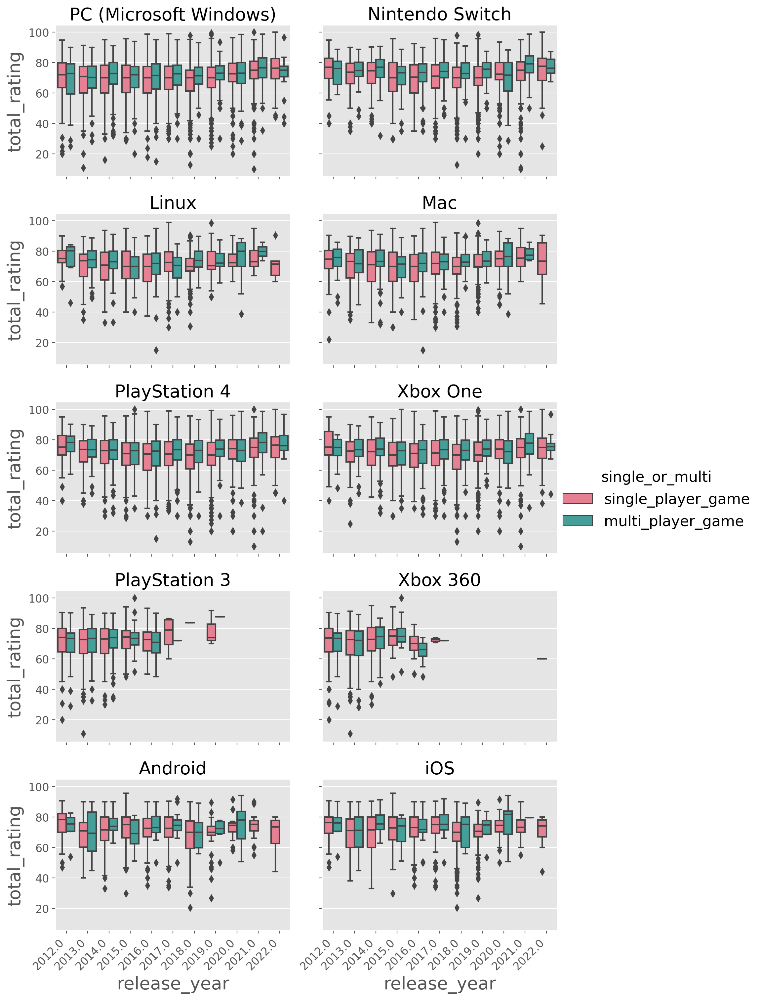

In [106]:
boxplot_for_rating_by_cat(x = 'release_year', hue = 'single_or_multi', col = 'platform_description')

PS3 and Xbox 360 production stopped around 2017 roughly. I am skeptical of the data for these platforms after that year.
Overall, both single and multi player game ratings seem to be on a decreasing trend prior to 2018 and increasing afterward. But the data seems to be incomplete in the last 2 years for some categories.

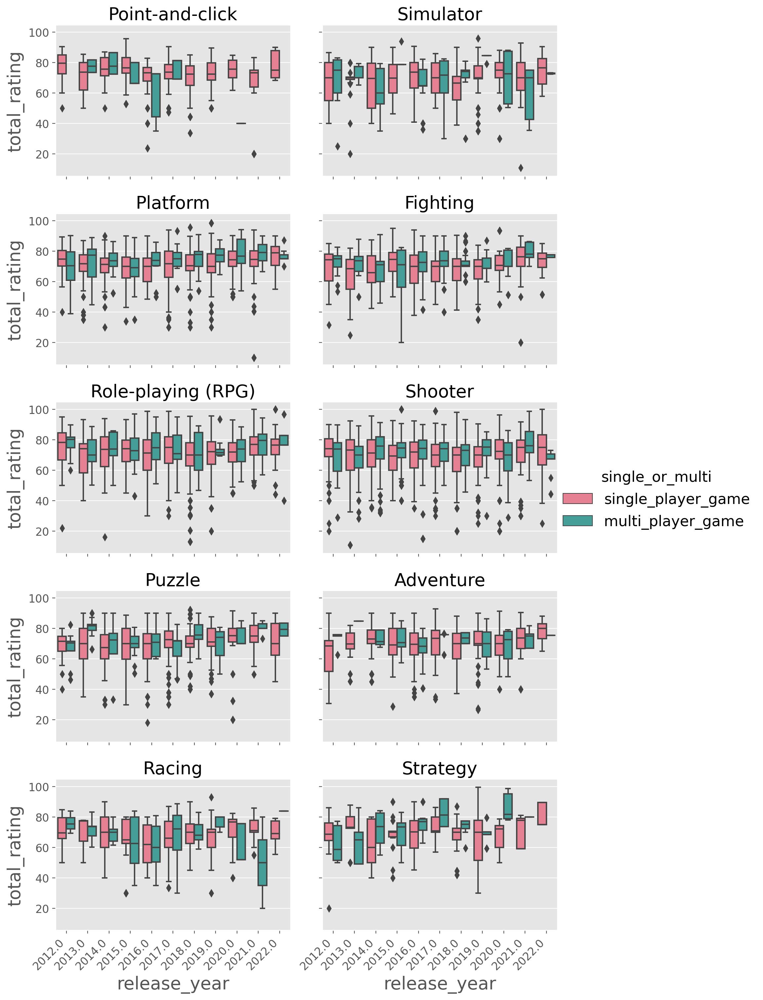

In [78]:
boxplot_for_rating_by_cat(x = 'release_year', hue = 'single_or_multi', col = 'genres_description_clean')

Strategy games have improved a lot over the years.
Racing multi player games seem to be going down.

Puzzle, RPG, Platform, Adventure, Fighting seem to have an increasing trend from the last few years.

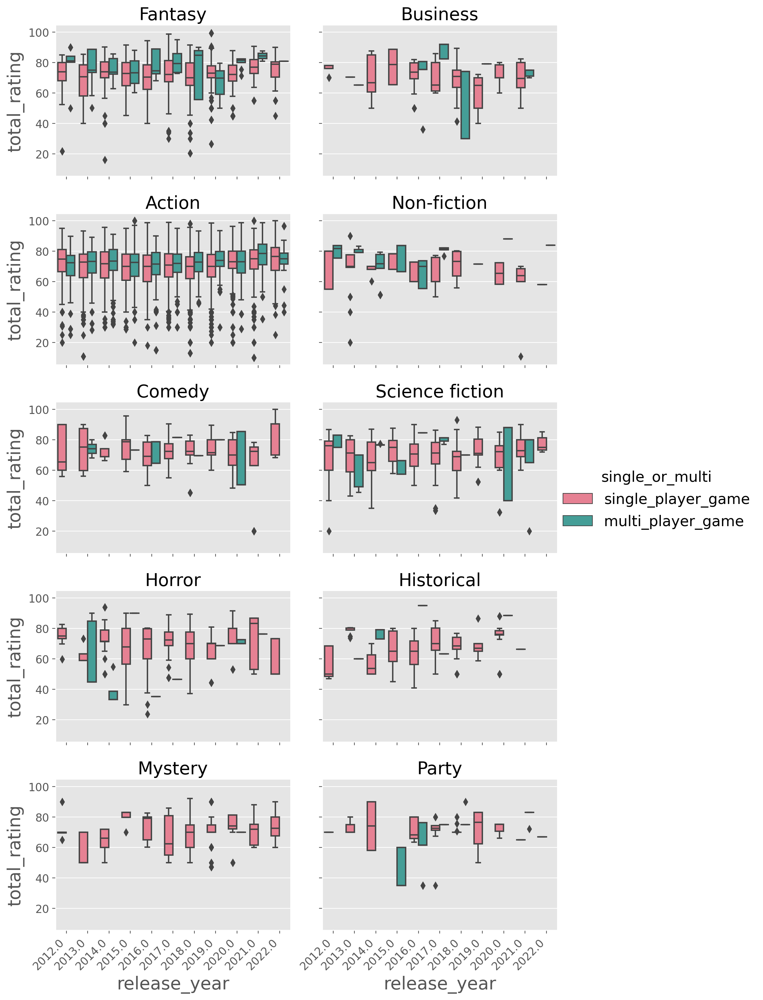

In [79]:
boxplot_for_rating_by_cat(x = 'release_year', hue = 'single_or_multi', col = 'themes_description_clean')

Action and Fantasy are most populated and seem to be on a healthy trend. No noteworthy insights for other themes.

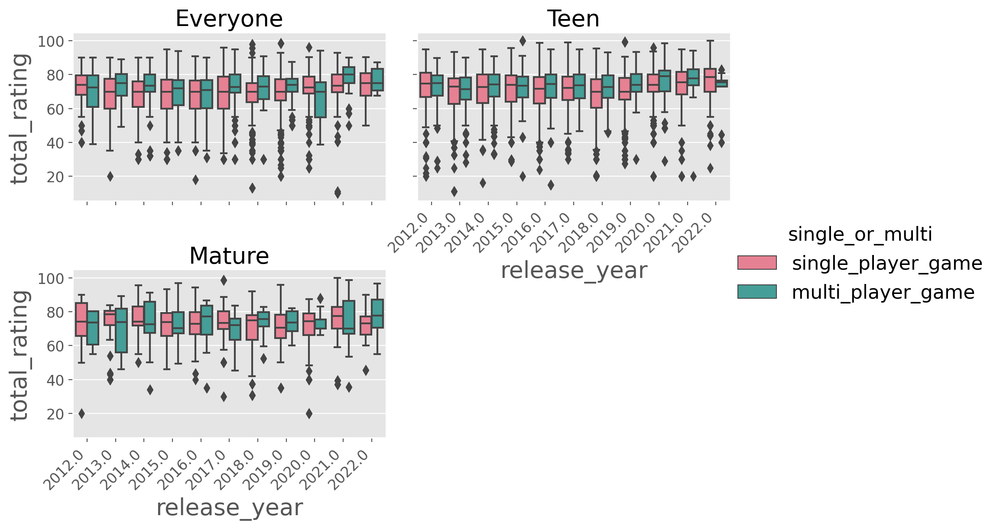

In [80]:
boxplot_for_rating_by_cat(x = 'release_year', hue = 'single_or_multi', col = 'age_group_clean')

For the last 5 years, Median rating for 'Everyone' group appears to be on an increasing trend for both single and multi player games.
Median rating for Teen multi player games dipped in 2018 and is on an upward trend from then onwards.
Median rating for Mature games seems to not follow any trend.

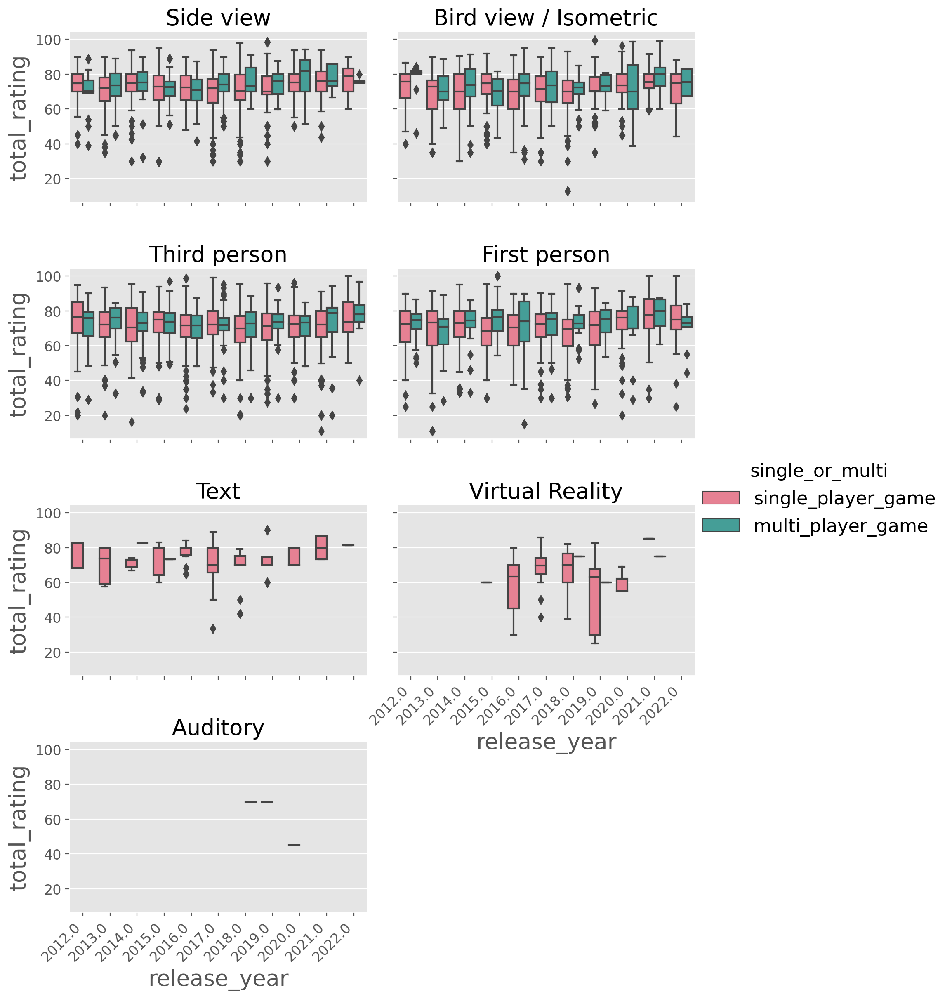

In [81]:
boxplot_for_rating_by_cat(x = 'release_year', hue = 'single_or_multi', col = 'player_perspectives_clean')

Most common views i.e, side view, top view, first person and third person views have increasing trend from the last 4 years.

Now let us see which platform excels for each genre (Adventure, RPG, Fighting, ...)

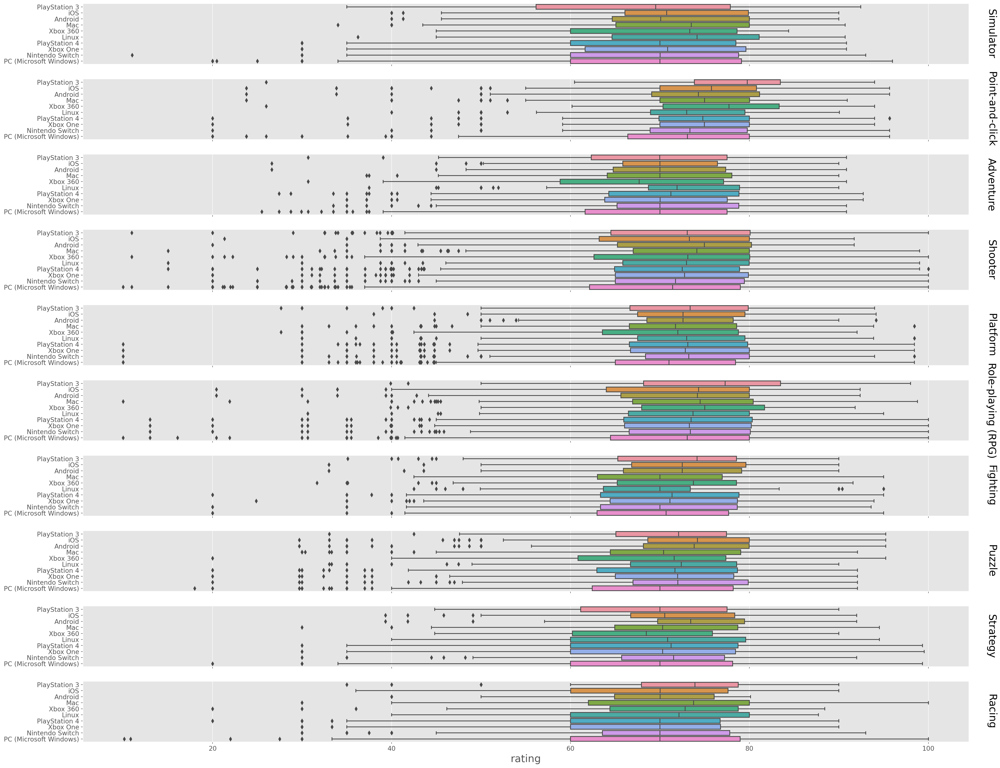

In [96]:
g = sns.catplot(
    data=df_cleaned_exploded,
    x="total_rating", y="platform_description", row="genres_description_clean",
    kind="box", orient="h", order = df_cleaned_exploded.groupby(['platform_description'])['total_rating'].median().sort_values(ascending=False).index,
    sharex=True, margin_titles=True,
    height=2, aspect=12,
)
g.set(xlabel="rating", ylabel="")
g.set_titles(row_template="{row_name}")

Platform with the highest median rating in each genre:

-   Simulator: Linux followed by Mac and Xbox 360.
-   Point and Click: PS3 followed by Xbox 360. Windows and Linux have the worst ratings. I wasn't expecting this at all for point and click games. 
-   Adventure: Linux followed by PS4. Linux has unusually high ratings here but that may be because only successful Windows games (most of the time) are made compatible for Linux and hence we see higher rating here.
-   Shooter: Android followed Mac. This is surprising that Android has higher ratings than other platforms as they offer better shooter game experience. Windows has the lowest median rating.
-   Platform: PS3 followed by Nintendo Switch
-   RPG: PS3 followed by Xbox 360
-   Fighting: PS3 followed by Xbox 360
-   Puzzle: iOS followed by Android
-   Strategy: Android
-   Racing: PS3 followed by Mac

In [97]:
#'release_year' removed
df_cleaned_exploded_top = df_cleaned_exploded.groupby(['platform_description','single_or_multi',
                                                       'genres_description_clean','themes_description_clean','age_group_clean',
                                                       'player_perspectives_clean']).agg(
                                                        {'total_rating': ['mean', 'median', 'size']                                                        
                                                        })#.reset_index()#.sort_values(by=['median','size'], ascending = False)
df_cleaned_exploded_top.columns = ['mean_rating','median_rating','group_size']

df_cleaned_exploded_top = df_cleaned_exploded_top.reset_index().sort_values(by=['median_rating','group_size'], ascending = [False,False])

df_cleaned_exploded_top

#df_cleaned_exploded_top.to_csv("median_ratings_for_groups.csv", index = False)

,platform_description,single_or_multi,genres_description_clean,themes_description_clean,age_group_clean,player_perspectives_clean,mean_rating,median_rating,group_size
1336,Nintendo Switch,single_player_game,Role-playing (RPG),Comedy,Teen,Third person,100.000000,100.000000,1
3421,Xbox One,single_player_game,Strategy,Fantasy,Teen,Bird view / Isometric,85.455735,99.341064,3
2401,PlayStation 4,multi_player_game,Role-playing (RPG),Fantasy,Everyone,Third person,95.000000,95.000000,1
3092,Xbox One,multi_player_game,Role-playing (RPG),Fantasy,Everyone,Third person,95.000000,95.000000,1
2074,PC (Microsoft Windows),single_player_game,Strategy,Fantasy,Mature,Side view,94.908513,94.908513,1
...,...,...,...,...,...,...,...,...,...
3417,Xbox One,single_player_game,Strategy,Action,Teen,Side view,30.000000,30.000000,1
75,Android,single_player_game,Adventure,Fantasy,Everyone,First person,26.610499,26.610499,1
3516,iOS,single_player_game,Adventure,Fantasy,Everyone,First person,26.610499,26.610499,1
2221,PlayStation 3,single_player_game,Point-and-click,Comedy,Teen,Third person,26.001594,26.001594,1


From the table above, it is challenging to see what really contributes to high ratings. 
Let us try to understand relationships between different categorical features with the help of a parallel categories diagram.
Since we have too many groups in each categorical feature, let's simplify it down to top 5 most frequently occuring groups to understand how they relate to total_rating.
Let's categorize total_rating into 3 groups - bad, good and great.
Any game that has a rating of less than 60 is bad, 61-75 is good and above 75 is great.

In [100]:
# Let's unpack this df based on platforms
#df_cleaned_exploded = df_cleaned.apply(lambda x: x.explode() if x.name == 'platform_description' else x).reset_index()

# Consider top categories. Too many categories will not be useful.
platform_categories = list(df_cleaned_exploded['platform_description'].value_counts().nlargest(5).index)
genres_categories = list(df_cleaned_exploded['genres_description_clean'].value_counts().nlargest(5).index)
themes_categories = list(df_cleaned_exploded['themes_description_clean'].value_counts().nlargest(5).index)
age_categories = list(df_cleaned_exploded['age_group_clean'].value_counts().nlargest(5).index)
player_perspectives_categories = list(df_cleaned_exploded['player_perspectives_clean'].value_counts().nlargest(5).index)

# Filtering the data for only top categories in each column
df_cleaned_exploded_simplified = df_cleaned_exploded[(df_cleaned_exploded['total_rating'] > 0) &
                                          (df_cleaned_exploded['platform_description'].isin(platform_categories)) &
                                          (df_cleaned_exploded['genres_description_clean'].isin(genres_categories)) &
                                          (df_cleaned_exploded['themes_description_clean'].isin(themes_categories)) &
                                          (df_cleaned_exploded['age_group_clean'].isin(age_categories)) &
                                          (df_cleaned_exploded['player_perspectives_clean'].isin(player_perspectives_categories))]#&
                                          #(df_cleaned_exploded['release_year'] > 2011)]

df_cleaned_exploded_simplified['rating_0_to_5'] = df_cleaned_exploded_simplified['total_rating']/20

#creating a column for bad, good and great indicator
df_cleaned_exploded_simplified['rating_cat'] = (
    np.select(
        condlist=[df_cleaned_exploded_simplified['total_rating'] < 60, (df_cleaned_exploded_simplified['total_rating'] >= 60) & (df_cleaned_exploded_simplified['total_rating'] <= 75),
        df_cleaned_exploded_simplified['total_rating'] > 75], 
        choicelist=["bad", "good", "great"], 
        default=""))

#creating a column with numbers for color scale
df_cleaned_exploded_simplified['rating_cat_code'] = (
    np.select(
        condlist=[df_cleaned_exploded_simplified['total_rating'] < 60, (df_cleaned_exploded_simplified['total_rating'] >= 60) & (df_cleaned_exploded_simplified['total_rating'] <= 75),
        df_cleaned_exploded_simplified['total_rating'] > 75], 
        choicelist=[0, 1, 2], 
        default=3))

df_cleaned_exploded_simplified.head()                                          

,index,category,created_at,first_release_date,genres,name,platforms,release_dates,similar_games,slug,status,summary,themes,updated_at,websites,age_ratings,involved_companies,game_engines,player_perspectives,videos,rating,rating_count,storyline,total_rating,total_rating_count,version_parent,version_title,hypes,franchises,follows,franchise,aggregated_rating,aggregated_rating_count,multiplayer_modes,dlcs,ports,expansions,remakes,expanded_games,remasters,standalone_expansions,forks,platform_description,genres_description,themes_description,age_group,player_perspectives_description,single_or_multi,log_hypes,log_follows,log_total_rating_count,age_group_clean,genres_description_clean,themes_description_clean,player_perspectives_clean,release_year,rating_0_to_5,rating_cat,rating_cat_code
108,663,0,2014-04-06 22:04:17,2005-02-23,[5],Project: Snowblind,"[6, 8, 11]","[27784, 27785, 27786, 27787, 27788, ...","[41, 356, 564, 571, 649, 1006, 1886,...",project-snowblind,NaN,Experience the dramatic intensity of...,"[1, 18]",2022-05-18 11:29:12,"[2920, 40854, 40855]","[6346, 10497]","[14405, 22590, 22591]",NaN,[1],[11574],63.002953,22.0,NaN,67.751476,26.0,NaN,NaN,NaN,NaN,3.0,NaN,72.500000,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PC (Microsoft Windows),[Shooter],"[Action, Science fiction]","[13+, 16+]",[First person],single_player_game,NaN,0.477121,1.414973,Teen,Shooter,Action,First person,2005.0,3.387574,good,1
124,745,4,2016-07-16 17:10:30,2005-10-01,[12],City of Villains,"[6, 14]","[188049, 188050]","[6, 660, 7027, 7129, 7830, 8747, 980...",city-of-villains,NaN,"CoV was released as an ""expanshalone...",[1],2022-05-11 20:52:27,"[8265, 153878]",[71653],"[37592, 37593, 37594]",NaN,[2],"[8944, 8945]",NaN,NaN,NaN,83.333333,3.0,NaN,NaN,NaN,NaN,NaN,NaN,83.333333,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PC (Microsoft Windows),[Role-playing (RPG)],[Action],[13+],[Third person],single_player_game,NaN,NaN,0.477121,Teen,Role-playing (RPG),Action,Third person,2005.0,4.166667,great,2
125,745,4,2016-07-16 17:10:30,2005-10-01,[12],City of Villains,"[6, 14]","[188049, 188050]","[6, 660, 7027, 7129, 7830, 8747, 980...",city-of-villains,NaN,"CoV was released as an ""expanshalone...",[1],2022-05-11 20:52:27,"[8265, 153878]",[71653],"[37592, 37593, 37594]",NaN,[2],"[8944, 8945]",NaN,NaN,NaN,83.333333,3.0,NaN,NaN,NaN,NaN,NaN,NaN,83.333333,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Mac,[Role-playing (RPG)],[Action],[13+],[Third person],single_player_game,NaN,NaN,0.477121,Teen,Role-playing (RPG),Action,Third person,2005.0,4.166667,great,2
134,801,0,2015-02-09 15:16:08,2005-11-11,[5],Shadowgrounds,"[3, 6, 14]","[26985, 26986, 26987, 26988, 26989, ...","[3277, 7350, 9806, 9931, 11646, 1544...",shadowgrounds,NaN,Shadowgrounds breathes fresh air int...,"[1, 18]",2022-06-22 03:14:33,"[15390, 67087, 119429, 183264]",[75708],"[22082, 22134, 22135, 22136, 43024]",NaN,[3],[16995],61.692546,16.0,NaN,68.346273,19.0,NaN,NaN,NaN,NaN,2.0,NaN,75.000000,3.0,"[1616, 7599]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PC (Microsoft Windows),[Shooter],"[Action, Science fiction]",[15+],[Bird view / Isometric],multi_player_game,NaN,0.301030,1.278754,Teen,Shooter,Action,Bird view / Isometric,2005.0,3.417314,good,1
135,801,0,2015-02-09 15:16:08,2005-11-11,[5],Shadowgrounds,"[3, 6, 14]","[26985, 26986, 26987, 26988, 26989, ...","[3277, 7350, 9806, 9931, 11646, 1544...",shadowgrounds,NaN,Shadowgrounds breathes fresh air int...,"[1, 18]",2022-06-22 03:14:33,"[15390, 67087, 119429, 183264]",[75708],"[22082, 22134, 22135, 22136, 43024]",NaN,[3],[16995],61.692546,16.0,NaN,68.346273,19.0,NaN,NaN,NaN,NaN,2.0,NaN,75.000000,3.0,"[1616, 7599]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Mac,[Shooter],"[Action, Science fiction]",[15+],[Bird view / Isometric],multi_player_game,NaN,0.301030,1.278754,Teen,Shooter,Action,Bird view / Isometric,2005.0,3.417314,good,1


In [101]:
# Create dimensions
platform_dim = go.parcats.Dimension(
    values=df_cleaned_exploded_simplified.platform_description, label="platform"
    #categoryorder='category ascending', label="platform"
)

age_dim = go.parcats.Dimension(values=df_cleaned_exploded_simplified.age_group_clean, label="age limit")

rating_dim = go.parcats.Dimension(
    values=df_cleaned_exploded_simplified.rating_cat_code, label="rating", categoryarray=[0,1,2],
    ticktext=['bad', 'good', 'great']
)

genres_dim = go.parcats.Dimension(values=df_cleaned_exploded_simplified.genres_description_clean, label="genre")

themes_dim = go.parcats.Dimension(values=df_cleaned_exploded_simplified.themes_description_clean, label="theme")

perspectives_dim = go.parcats.Dimension(values=df_cleaned_exploded_simplified.player_perspectives_clean, label="perspective")

# Create parcats trace
color = df_cleaned_exploded_simplified.rating_cat_code;
colorscale = "BuGn";

fig = go.Figure(data = [go.Parcats(dimensions=[age_dim, platform_dim, themes_dim, genres_dim, perspectives_dim, rating_dim],#platform_dim, themes_dim, genres_dim, perspectives_dim
        line={'color': color, 'colorscale': colorscale},
        hoveron='color', hoverinfo='count+probability',
        labelfont={'size': 18, 'family': 'Times'},
        tickfont={'size': 16, 'family': 'Times'},
        arrangement='freeform')])

fig.show()

This is a lot but let's unpack this slowly by taking a look at the probabilities.

The plot by itself is not so useful as there are too many categorical features but if we hover over each group, we can see three probabilities here:

1) P(Color and age limit group). Example: If we highlight white block (bad) in age limit category, we would see P(bad and Teen) = 0.074. It means 7.4% of the games are bad and belong to teen age group.
   If we add up these probabilities for all combinations under age limit category (bad and teen, good and teen, great and teen, bad and Everyone, good and Everyone, great and Everyone, ....) they would all sum up to 1.

2) P(age limit group | Color). Example: If we highlight white block (bad) in age limit category, we would see P(Teen | bad) = 0.559. Given that a game is bad, the chance that it is from Teen group is 55.9%.
   If we add up P(Teen | bad), P(Everyone | bad) and P(Mature | bad), it the sums up to 1 (0.559 + 0.365 + 0.077).  

3) P(Color | age limit group). If we highlight white block (bad) in age limit category, we would see P(bad | Teen) = 0.132. It means given that a game is bad, the chance that it belongs to Teen group is 13.2%.
    If we add up P(bad | Teen), P(good | Teen), P(great | Teen), they all sum up to 1.

The first two probabilities are affected by the proportion of the observations in the dataset while the third is not. The third is the one we are most interested in.

Let us see what groups are contributing most to the great games regardless of the proportion of games.

These 2 tables below show group within each category that has most great or most bad games.


Group |% of games that are great given a category group
-----|-----
Mature|49%. In other words, in age limit category, 49% of the games will be great given they belong to Mature group.
Mac|44%. This is only 4% higher than PC Windows and 2% higher than other platforms. May be platform doesn't matter?
Fantasy|48%
RPG|46%
Text View|49% (There are very few text games but their rating seems to be high). If we only consider popular views, then first person and side view have great games (43%).




Group |% of games that are bad given a category group
-----|-----
Everyone|14% (but all the groups fall around same percentage)
PC Windows|15% (rest of the groups have 11-13% range)
Horror|26% (while Fantasy has only 11%)
Shooter|15% (Rest of the genres fall very close)
First Person|17% (Side view has only 10%)

It looks like bad games proportion is very less among groups while great games come from the above mentioned groups above 40% of the time.

The bad, good and great buckets we created have different proportion of games that fall into each.

This means that there are not many games (only 13% of all games fall under bad group while 46% and 40% fall under good and great groups) with less than rating 60 and we should consider defining bad category at higher than 60 to make more games fall under that category and see how percentage changes. 

# 6. Brief Conclusion of the EDA

**Key Takeaways:**

1) Most of the data was either missing or structured in a way that cannot be easily analyzed. Work around: Cleaning and simplifying the data with some assumptions.

2) Majority of the ratings are between 50 and 80 with peaking at 70.

3) Proportion of games in dataset: Windows ~28%, Mac ~9%, PS4 ~7%, Linux ~6.5%, Xbox One ~6%, Nintendo Switch ~6%. Rest of them have less than 6%.

4) Several unique values in each categorical feature make it harder to gain meaningful insights. Had to consider top 10 most frequently occuring values for most of the analysis.

5) With great moderation comes great quality! iOS had better rating distribution than other platforms.

6) 7th Generation consoles (PS3 and Xbox 360) had better ratings than their next gen counterparts. This might be because of bigger library of great games with backward compatibility.

7) Linux and Mac have better ratings than Windows BUT only successful or well known frachise games are made compatible with Linux and Mac. This makes it look like they have better ratings. Thus they have an obvious 
advantage over Windows which has a plethora of bad and good games.
8) No. of follows for a game doesn't affect the rating but it affects how many people rate the game.

9) Multi player games received higher ratings than single player games. This is expected as these are games that receive (atleast in majority of the cases) the bigger budgets, better development teams, and 
relatively lenient time schedules. These are the games that publishers want to be the biggest of the year, and they do everything they can up to launch to ensure those results. They are more profitable (in-game 
purchases) and have higher bar to deliver and cater to thousands if not millions of gamers where as most single player games are a one time purchase and fall a little short in generating recurring profits.

10) Although they are less than 5% of the proportion, Mature age rated games received higher ratings than Teen or Everyone rated games. Mature games grab away all the awards as well. They have more freedom in story-telling/character and level design/gameplay and have more attention to detail. Thus, they clearly have more chance to deliver better impact and experience to a gamer.

11) Platform with the highest median rating in each genre:

-   Simulator: Linux followed by Mac and Xbox 360.
-   Point and Click: PS3 followed by Xbox 360. Windows and Linux have the worst ratings. I wasn't expecting this at all for point and click games. 
-   Adventure: Linux followed by PS4. Linux has unusually high ratings here but that may be because only successful Windows games (most of the time) are made compatible for Linux and hence we see higher rating here.
-   Shooter: Android followed Mac. This is surprising that Android has higher ratings than other platforms as they offer better shooter game experience. Windows has the lowest median rating.
-   Platform: PS3 followed by Nintendo Switch
-   RPG: PS3 followed by Xbox 360
-   Fighting: PS3 followed by Xbox 360
-   Puzzle: iOS followed by Android
-   Strategy: Android
-   Racing: PS3 followed by Mac

12) 

Group |% of games that are great given a category group
-----|-----
Mature|49%. In other words, in age limit category, 49% of the games will be great given they belong to Mature group.
Mac|44%. This is only 4% higher than PC Windows and 2% higher than other platforms. May be platform doesn't matter?
Fantasy|48%
RPG|46%
Text View|49% (There are very few text games but their rating seems to be high). If we only consider popular views, then first person and side view have great games (43%).

13) Last but not least, we should accept that the results here are based on several assumptions (example - genres and themes are tagged correctly for games), one of which is that this dataset is a representative sample of the games released in the world and is not already biased for any particular group. For example, If PS3 had only well known games added to IGDB database, it would invalidate our results.

**Expansion Ideas**
- Publishers and Developers data can be analyzed to see how they do in terms of rating.
- If there are separate ratings for gameplay, controls, level design, challenge, characters, etc. it would give more insight into what role they actually play in making a game great.
- It would be interesting to see to what extent higher rating influences game sales.
- Do games that do not have similar games associated with them receive higher rating when compared to games that have many similar games?
- Would be interesting to see if games with websites associated with them have higher hype or rating?
- Assigning more weightage to rating based on how many people have rated a game.